Team GrossUndKlein: Luca Dock, Daniel Drechsler, Johannes Karcher

Projekt : Oxford 102 Flowers Classification

Disclaimer: AI (CHATGPT and CLAUDE SONNET) was used to help fix bugs, rewrite code efficiently and to help make better plots and visualizations.

In [1]:
import torch
from torch.utils.data import Dataset, DataLoader
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from scipy.io import loadmat
from torchvision import transforms
from sklearn.model_selection import train_test_split

In [2]:
# CUDA Verfügbarkeit prüfen und Device setzen
if torch.cuda.is_available():
    device = torch.device("cuda")
    print(f"  CUDA ist verfügbar!")
    print(f"  GPU: {torch.cuda.get_device_name(0)}")
    print(f"  CUDA Version: {torch.version.cuda}")
    print(f"  Anzahl GPUs: {torch.cuda.device_count()}")
    print(f"  Aktuelles Device: {device}")
else:
    device = torch.device("cpu")
    print("⚠ CUDA ist nicht verfügbar. Verwende CPU.")
    print(f"  Aktuelles Device: {device}")


  CUDA ist verfügbar!
  GPU: NVIDIA GeForce RTX 3090
  CUDA Version: 12.6
  Anzahl GPUs: 1
  Aktuelles Device: cuda


In [3]:
# Data + Labels
data_dir = 'data/102flowers/jpg'
labels_file = 'data/imagelabels.mat'

# Load labels from .mat file
mat_data = loadmat(labels_file)
labels = mat_data['labels'][0]  # Labels are 1-indexed (1-102)

print(f"Total images: {len(labels)}")
print(f"Number of classes: {len(np.unique(labels))}")


Total images: 8189
Number of classes: 102


In [4]:
class FlowersDataset(Dataset):
    def __init__(self, image_dir, labels, indices, transform=None):
        self.image_dir = image_dir
        self.labels = labels
        self.indices = indices
        self.transform = transform

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        img_idx = self.indices[idx]
        # Image filenames are 1-indexed: image_00001.jpg to image_08189.jpg
        img_name = f'image_{img_idx+1:05d}.jpg'
        img_path = os.path.join(self.image_dir, img_name)

        # Load image
        image = Image.open(img_path).convert('RGB')

        # Get label (convert from 1-indexed to 0-indexed)
        label = self.labels[img_idx] - 1

        # Apply transforms
        if self.transform:
            image = self.transform(image)

        return image, label



Anzahl Bilddateien gefunden: 8189

Anzahl Klassen: 102

Produkt der Dimensionen:
   Min: 750,000
   Max: 2,167,662
   Mean: 996,829
   Median: 1,000,500

Seitenverhältnisse (Width/Height):
   Min: 0.428
   Max: 2.048
   Mean: 1.210
   Median: 1.332

Mittlere Pixelwerte pro Kanal:
   Rot-Kanal   - Min: 77.91, Max: 150.92, Mean: 111.30
   Grün-Kanal  - Min: 39.14, Max: 127.87, Mean: 98.27
   Blau-Kanal  - Min: 22.12, Max: 118.08, Mean: 75.43


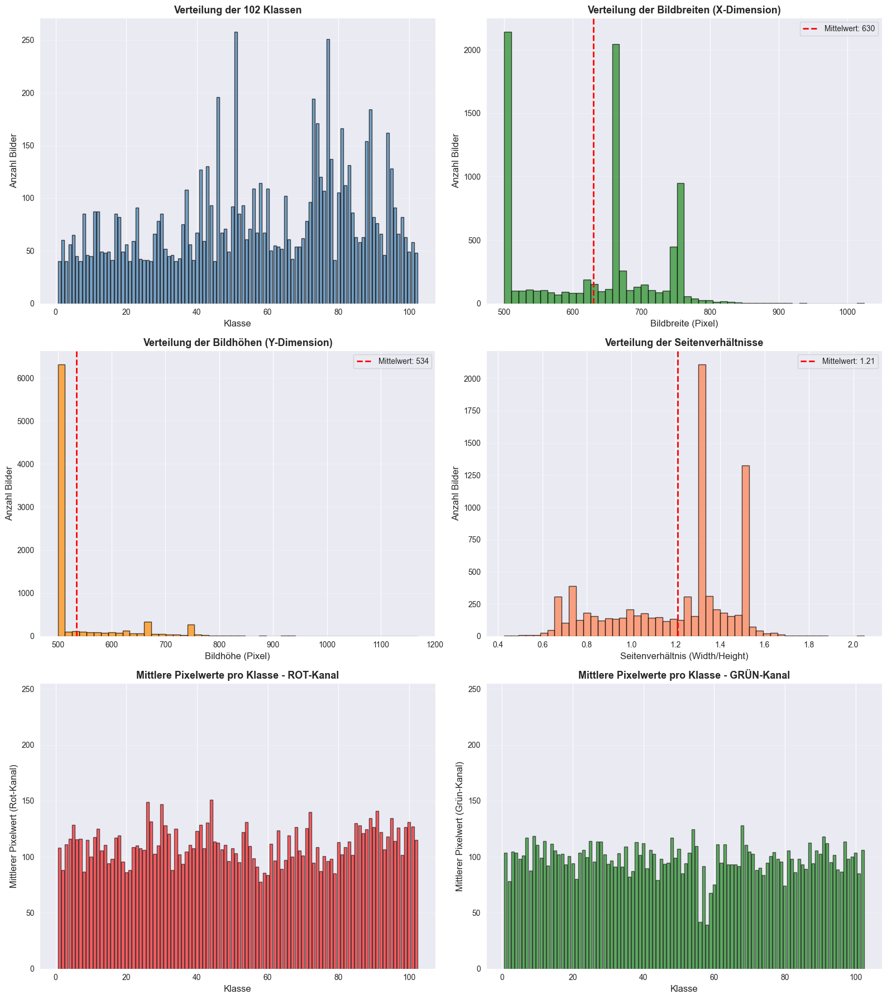

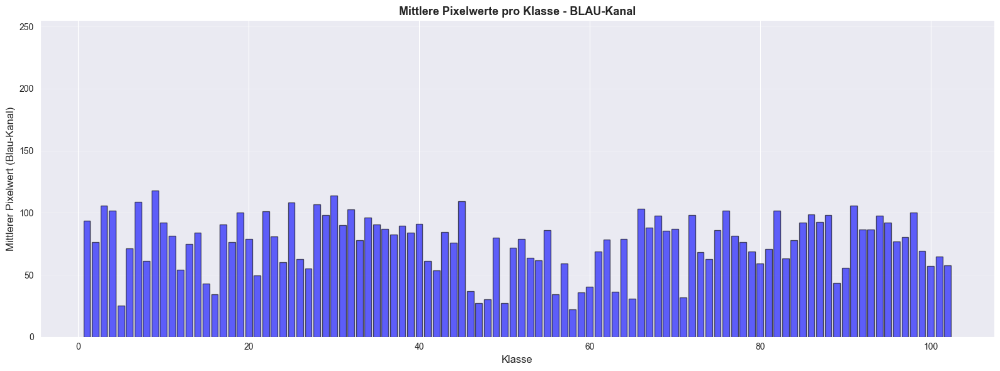

In [5]:
# Dataset Analyse (Histogramme)
# Laden der Bilder
image_files = sorted([f for f in os.listdir(data_dir) if f.endswith(('.jpg', '.jpeg', '.png'))])
print(f"\nAnzahl Bilddateien gefunden: {len(image_files)}")

# Anzahl Klassen
num_classes = len(np.unique(labels))
print(f"\nAnzahl Klassen: {num_classes}")

# Initialisiere Listen für Bilddimensionen und Pixelwerte
widths = []  # Breite der Bilder (x-Dimension)
heights = []  # Höhe der Bilder (y-Dimension)
aspect_ratios = []

# RGB-Werte separat pro Klasse: {klasse: {'r': [], 'g': [], 'b': []}}
pixel_values_per_class_rgb = {i: {'r': [], 'g': [], 'b': []} for i in range(1, num_classes + 1)}

for idx, image_file in enumerate(image_files):
    try:
        img = Image.open(os.path.join(data_dir, image_file))
        img_array = np.array(img)
        
        h, w, c = img_array.shape
        
        # Breite und Höhe separat speichern
        widths.append(w)
        heights.append(h)
        
        # Seitenverhältnis berechnen
        aspect_ratio = w / h
        aspect_ratios.append(aspect_ratio)
        
        # Label für dieses Bild (Index + 1 wegen 1-basierter Labels)
        label = labels[idx]
        
        # RGB-Werte separat pro Kanal berechnen
        mean_r = np.mean(img_array[:, :, 0])  # Rot-Kanal
        mean_g = np.mean(img_array[:, :, 1])  # Grün-Kanal
        mean_b = np.mean(img_array[:, :, 2])  # Blau-Kanal
        
        pixel_values_per_class_rgb[label]['r'].append(mean_r)
        pixel_values_per_class_rgb[label]['g'].append(mean_g)
        pixel_values_per_class_rgb[label]['b'].append(mean_b)
        
    except Exception as e:
        print(f"Fehler bei Bild {image_file}: {e}")


# Produkt der Dimensionen (H×W×C)
image_dimensions = [w * h * 3 for w, h in zip(widths, heights)]  # 3 Kanäle (RGB)
print(f"\nProdukt der Dimensionen:")
print(f"   Min: {np.min(image_dimensions):,.0f}")
print(f"   Max: {np.max(image_dimensions):,.0f}")
print(f"   Mean: {np.mean(image_dimensions):,.0f}")
print(f"   Median: {np.median(image_dimensions):,.0f}")

# Seitenverhältnisse
print(f"\nSeitenverhältnisse (Width/Height):")
print(f"   Min: {np.min(aspect_ratios):.3f}")
print(f"   Max: {np.max(aspect_ratios):.3f}")
print(f"   Mean: {np.mean(aspect_ratios):.3f}")
print(f"   Median: {np.median(aspect_ratios):.3f}")

# Mittlere Pixelwerte pro Klasse und Kanal
class_means_r = {k: np.mean(v['r']) if len(v['r']) > 0 else 0 for k, v in pixel_values_per_class_rgb.items()}
class_means_g = {k: np.mean(v['g']) if len(v['g']) > 0 else 0 for k, v in pixel_values_per_class_rgb.items()}
class_means_b = {k: np.mean(v['b']) if len(v['b']) > 0 else 0 for k, v in pixel_values_per_class_rgb.items()}

print(f"\nMittlere Pixelwerte pro Kanal:")
print(f"   Rot-Kanal   - Min: {np.min(list(class_means_r.values())):.2f}, Max: {np.max(list(class_means_r.values())):.2f}, Mean: {np.mean(list(class_means_r.values())):.2f}")
print(f"   Grün-Kanal  - Min: {np.min(list(class_means_g.values())):.2f}, Max: {np.max(list(class_means_g.values())):.2f}, Mean: {np.mean(list(class_means_g.values())):.2f}")
print(f"   Blau-Kanal  - Min: {np.min(list(class_means_b.values())):.2f}, Max: {np.max(list(class_means_b.values())):.2f}, Mean: {np.mean(list(class_means_b.values())):.2f}")

# Histogramme erstellen
fig, axes = plt.subplots(3, 2, figsize=(16, 18))

# Bilder pro Klasse
unique_labels, counts = np.unique(labels, return_counts=True)
axes[0, 0].bar(unique_labels, counts, color='steelblue', edgecolor='black', alpha=0.7)
axes[0, 0].set_xlabel('Klasse', fontsize=12)
axes[0, 0].set_ylabel('Anzahl Bilder', fontsize=12)
axes[0, 0].set_title(f'Verteilung der {num_classes} Klassen', fontsize=13, fontweight='bold')
axes[0, 0].grid(axis='y', alpha=0.3)

# Bildbreiten (x-Dimension)
axes[0, 1].hist(widths, bins=50, color='forestgreen', edgecolor='black', alpha=0.7)
axes[0, 1].set_xlabel('Bildbreite (Pixel)', fontsize=12)
axes[0, 1].set_ylabel('Anzahl Bilder', fontsize=12)
axes[0, 1].set_title('Verteilung der Bildbreiten (X-Dimension)', fontsize=13, fontweight='bold')
axes[0, 1].grid(axis='y', alpha=0.3)
axes[0, 1].axvline(np.mean(widths), color='red', linestyle='--', linewidth=2, label=f'Mittelwert: {np.mean(widths):.0f}')
axes[0, 1].legend()

# Bildhöhen (y-Dimension)
axes[1, 0].hist(heights, bins=50, color='darkorange', edgecolor='black', alpha=0.7)
axes[1, 0].set_xlabel('Bildhöhe (Pixel)', fontsize=12)
axes[1, 0].set_ylabel('Anzahl Bilder', fontsize=12)
axes[1, 0].set_title('Verteilung der Bildhöhen (Y-Dimension)', fontsize=13, fontweight='bold')
axes[1, 0].grid(axis='y', alpha=0.3)
axes[1, 0].axvline(np.mean(heights), color='red', linestyle='--', linewidth=2, label=f'Mittelwert: {np.mean(heights):.0f}')
axes[1, 0].legend()

# Seitenverhältnisse
axes[1, 1].hist(aspect_ratios, bins=50, color='coral', edgecolor='black', alpha=0.7)
axes[1, 1].set_xlabel('Seitenverhältnis (Width/Height)', fontsize=12)
axes[1, 1].set_ylabel('Anzahl Bilder', fontsize=12)
axes[1, 1].set_title('Verteilung der Seitenverhältnisse', fontsize=13, fontweight='bold')
axes[1, 1].grid(axis='y', alpha=0.3)
axes[1, 1].axvline(np.mean(aspect_ratios), color='red', linestyle='--', linewidth=2, label=f'Mittelwert: {np.mean(aspect_ratios):.2f}')
axes[1, 1].legend()

# Mittlere Rot-Kanal Werte pro Klasse
classes = sorted(class_means_r.keys())
r_values = [class_means_r[k] for k in classes]
axes[2, 0].bar(classes, r_values, color='red', edgecolor='black', alpha=0.6)
axes[2, 0].set_xlabel('Klasse', fontsize=12)
axes[2, 0].set_ylabel('Mittlerer Pixelwert (Rot-Kanal)', fontsize=12)
axes[2, 0].set_title('Mittlere Pixelwerte pro Klasse - ROT-Kanal', fontsize=13, fontweight='bold')
axes[2, 0].grid(axis='y', alpha=0.3)
axes[2, 0].set_ylim((0, 255))

# Mittlere Grün-Kanal Werte pro Klasse
g_values = [class_means_g[k] for k in classes]
axes[2, 1].bar(classes, g_values, color='green', edgecolor='black', alpha=0.6)
axes[2, 1].set_xlabel('Klasse', fontsize=12)
axes[2, 1].set_ylabel('Mittlerer Pixelwert (Grün-Kanal)', fontsize=12)
axes[2, 1].set_title('Mittlere Pixelwerte pro Klasse - GRÜN-Kanal', fontsize=13, fontweight='bold')
axes[2, 1].grid(axis='y', alpha=0.3)
axes[2, 1].set_ylim((0, 255))

plt.tight_layout()
plt.show()

# Zusätzliches Diagramm für Blau-Kanal
fig2, ax = plt.subplots(1, 1, figsize=(16, 6))
b_values = [class_means_b[k] for k in classes]
ax.bar(classes, b_values, color='blue', edgecolor='black', alpha=0.6)
ax.set_xlabel('Klasse', fontsize=12)
ax.set_ylabel('Mittlerer Pixelwert (Blau-Kanal)', fontsize=12)
ax.set_title('Mittlere Pixelwerte pro Klasse - BLAU-Kanal', fontsize=13, fontweight='bold')
ax.grid(axis='y', alpha=0.3)
ax.set_ylim((0, 255))
plt.tight_layout()
plt.show()


PIXEL DIMENSION ANALYSIS (H×B)
Median Pixelanzahl: 333,500
Min Pixelanzahl: 250,000
Max Pixelanzahl: 722,554


Top 5 Klassen mit meisten Bildern in UPPER dimensions (>= 333,500 pixels)

1. Klasse 51:
   Gesamt Bilder: 258
   Bilder in UPPER dimensions: 183 (70.9%)
   Bilder in LOWER dimensions: 75 (29.1%)
   Unterste Indexes:  [142 168 160  41 250]
   Durchschnittliche Pixelanzahl: 345,838

2. Klasse 46:
   Gesamt Bilder: 196
   Bilder in UPPER dimensions: 181 (92.3%)
   Bilder in LOWER dimensions: 15 (7.7%)
   Unterste Indexes:  [  7 165 119  71  54]
   Durchschnittliche Pixelanzahl: 368,548

3. Klasse 77:
   Gesamt Bilder: 251
   Bilder in UPPER dimensions: 170 (67.7%)
   Bilder in LOWER dimensions: 81 (32.3%)
   Unterste Indexes:  [  4   8  62 163 203]
   Durchschnittliche Pixelanzahl: 330,890

4. Klasse 73:
   Gesamt Bilder: 194
   Bilder in UPPER dimensions: 154 (79.4%)
   Bilder in LOWER dimensions: 40 (20.6%)
   Unterste Indexes:  [ 71 190  55 129 144]
   Durchschnittliche Pixel

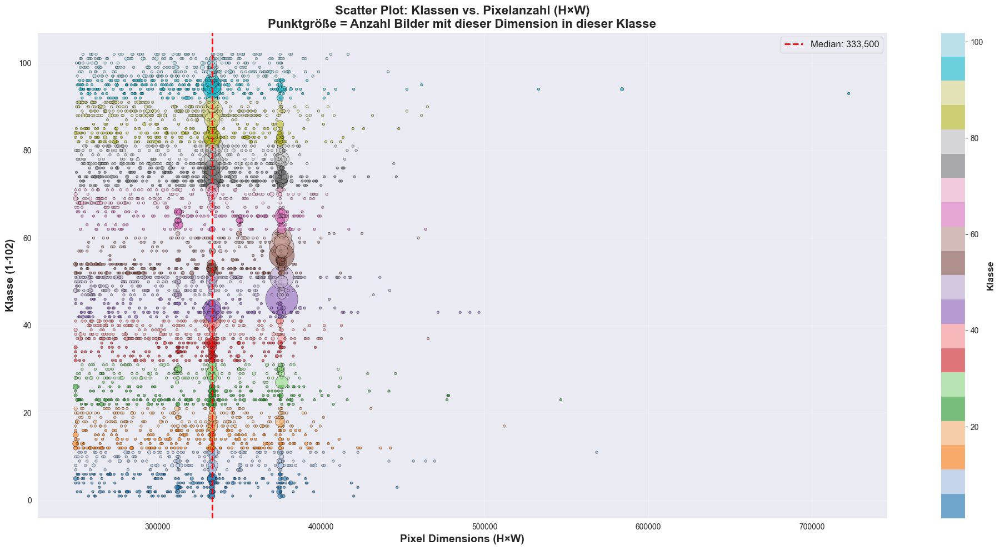

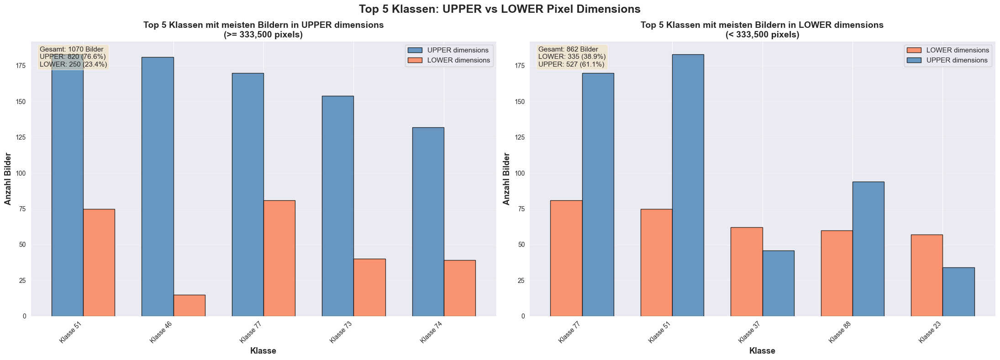

In [6]:
# Berechne Pixelanzahl (H*W) für jedes Bild
pixel_counts = [w * h for w, h in zip(widths, heights)]

# Gruppiere Daten nach Klassen
class_pixel_data = {i: [] for i in range(1, num_classes + 1)}
for idx, pixel_count in enumerate(pixel_counts):
    label = labels[idx]
    class_pixel_data[label].append((pixel_count))

# Bestimme Median der Pixelanzahl als Trennlinie zwischen "upper" und "lower"
median_pixel_count = np.median(pixel_counts)
print(f"PIXEL DIMENSION ANALYSIS (H×B)")
print(f"Median Pixelanzahl: {median_pixel_count:,.0f}")
print(f"Min Pixelanzahl: {np.min(pixel_counts):,.0f}")
print(f"Max Pixelanzahl: {np.max(pixel_counts):,.0f}")

# Analysiere jede Klasse: Anzahl Bilder in upper/lower dimensions
class_stats = {}
for class_id in range(1, num_classes + 1):
    pixels = class_pixel_data[class_id]
    total_images = len(pixels)
    upper_images = sum(1 for p in pixels if p >= median_pixel_count)
    lower_images = sum(1 for p in pixels if p < median_pixel_count)
    lowest_image_indexes = np.argsort(pixels)[:5]  # Indizes der 5 Bilder mit niedrigster Pixelanzahl
    class_stats[class_id] = {
        'total': total_images,
        'upper': upper_images,
        'lower': lower_images,
        'lowest_indexes': lowest_image_indexes,
        'upper_pct': (upper_images / total_images * 100) if total_images > 0 else 0,
        'lower_pct': (lower_images / total_images * 100) if total_images > 0 else 0,
        'mean_pixels': np.mean(pixels) if len(pixels) > 0 else 0
    }

# Top 5 Klassen mit meisten Bildern in UPPER dimensions
top_upper_classes = sorted(class_stats.items(), key=lambda x: x[1]['upper'], reverse=True)[:5]

# Top 5 Klassen mit meisten Bildern in LOWER dimensions
top_lower_classes = sorted(class_stats.items(), key=lambda x: x[1]['lower'], reverse=True)[:5]

print(f"\n\nTop 5 Klassen mit meisten Bildern in UPPER dimensions (>= {median_pixel_count:,.0f} pixels)")
for rank, (class_id, stats) in enumerate(top_upper_classes, 1):
    print(f"\n{rank}. Klasse {class_id}:")
    print(f"   Gesamt Bilder: {stats['total']}")
    print(f"   Bilder in UPPER dimensions: {stats['upper']} ({stats['upper_pct']:.1f}%)")
    print(f"   Bilder in LOWER dimensions: {stats['lower']} ({stats['lower_pct']:.1f}%)")
    print(f"   Unterste Indexes:  {stats['lowest_indexes']}")
    print(f"   Durchschnittliche Pixelanzahl: {stats['mean_pixels']:,.0f}")

print(f"\n\nTop 5 Klassen mit meisten Bildern in LOWER dimensions (< {median_pixel_count:,.0f} pixels)")
for rank, (class_id, stats) in enumerate(top_lower_classes, 1):
    print(f"\n{rank}. Klasse {class_id}:")
    print(f"   Gesamt Bilder: {stats['total']}")
    print(f"   Bilder in LOWER dimensions: {stats['lower']} ({stats['lower_pct']:.1f}%)")
    print(f"   Bilder in UPPER dimensions: {stats['upper']} ({stats['upper_pct']:.1f}%)")
    print(f"   Unterste Indexes:  {stats['lowest_indexes']}")
    print(f"   Durchschnittliche Pixelanzahl: {stats['mean_pixels']:,.0f}")

#Scatter-plot
# Für jede Dimension (H*W), zähle wie viele Bilder pro Klasse
dimension_class_counts = {}
for idx, pixel_count in enumerate(pixel_counts):
    label = labels[idx]
    key = (pixel_count, label)
    dimension_class_counts[key] = dimension_class_counts.get(key, 0) + 1

# Pixelanzahl, Klasse und Anzahl Bilder
x_scatter = [k[0] for k in dimension_class_counts.keys()]
y_scatter = [k[1] for k in dimension_class_counts.keys()]
sizes = [dimension_class_counts[k] * 10 for k in dimension_class_counts.keys()]  # Skalierung für Sichtbarkeit

# Scatter Plot
fig, ax = plt.subplots(1, 1, figsize=(20, 10))
scatter = ax.scatter(x_scatter, y_scatter, s=sizes, alpha=0.6, c=y_scatter, cmap='tab20', edgecolors='black', linewidth=0.5)

# Median-Linie
ax.axvline(median_pixel_count, color='red', linestyle='--', linewidth=2, label=f'Median: {median_pixel_count:,.0f}')

ax.set_xlabel('Pixel Dimensions (H×W)', fontsize=14, fontweight='bold')
ax.set_ylabel('Klasse (1-102)', fontsize=14, fontweight='bold')
ax.set_title('Scatter Plot: Klassen vs. Pixelanzahl (H×W)\nPunktgröße = Anzahl Bilder mit dieser Dimension in dieser Klasse', 
             fontsize=16, fontweight='bold')
ax.grid(True, alpha=0.3)
ax.legend(fontsize=12)

cbar = plt.colorbar(scatter, ax=ax)
cbar.set_label('Klasse', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(22, 8))
fig.suptitle('Top 5 Klassen: UPPER vs LOWER Pixel Dimensions', fontsize=18, fontweight='bold')

# Top 5 UPPER Dimensions
top_upper_ids = [c[0] for c in top_upper_classes]
upper_totals = [c[1]['total'] for c in top_upper_classes]
upper_upper = [c[1]['upper'] for c in top_upper_classes]
upper_lower = [c[1]['lower'] for c in top_upper_classes]

x_pos = np.arange(len(top_upper_ids))
bar_width = 0.35

axes[0].bar(x_pos - bar_width/2, upper_upper, bar_width, label='UPPER dimensions', color='steelblue', edgecolor='black', alpha=0.8)
axes[0].bar(x_pos + bar_width/2, upper_lower, bar_width, label='LOWER dimensions', color='coral', edgecolor='black', alpha=0.8)

axes[0].set_xlabel('Klasse', fontsize=13, fontweight='bold')
axes[0].set_ylabel('Anzahl Bilder', fontsize=13, fontweight='bold')
axes[0].set_title(f'Top 5 Klassen mit meisten Bildern in UPPER dimensions\n(>= {median_pixel_count:,.0f} pixels)', 
                  fontsize=14, fontweight='bold')
axes[0].set_xticks(x_pos)
axes[0].set_xticklabels([f'Klasse {c}' for c in top_upper_ids], rotation=45, ha='right')
axes[0].legend(fontsize=11)
axes[0].grid(axis='y', alpha=0.3)

info_text_upper = f"Gesamt: {sum(upper_totals)} Bilder\n"
info_text_upper += f"UPPER: {sum(upper_upper)} ({sum(upper_upper)/sum(upper_totals)*100:.1f}%)\n"
info_text_upper += f"LOWER: {sum(upper_lower)} ({sum(upper_lower)/sum(upper_totals)*100:.1f}%)"
axes[0].text(0.02, 0.98, info_text_upper, transform=axes[0].transAxes, 
             fontsize=11, verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

# Top 5 LOWER Dimensions
top_lower_ids = [c[0] for c in top_lower_classes]
lower_totals = [c[1]['total'] for c in top_lower_classes]
lower_lower = [c[1]['lower'] for c in top_lower_classes]
lower_upper = [c[1]['upper'] for c in top_lower_classes]

x_pos = np.arange(len(top_lower_ids))

axes[1].bar(x_pos - bar_width/2, lower_lower, bar_width, label='LOWER dimensions', color='coral', edgecolor='black', alpha=0.8)
axes[1].bar(x_pos + bar_width/2, lower_upper, bar_width, label='UPPER dimensions', color='steelblue', edgecolor='black', alpha=0.8)

axes[1].set_xlabel('Klasse', fontsize=13, fontweight='bold')
axes[1].set_ylabel('Anzahl Bilder', fontsize=13, fontweight='bold')
axes[1].set_title(f'Top 5 Klassen mit meisten Bildern in LOWER dimensions\n(< {median_pixel_count:,.0f} pixels)', 
                  fontsize=14, fontweight='bold')
axes[1].set_xticks(x_pos)
axes[1].set_xticklabels([f'Klasse {c}' for c in top_lower_ids], rotation=45, ha='right')
axes[1].legend(fontsize=11)
axes[1].grid(axis='y', alpha=0.3)

info_text_lower = f"Gesamt: {sum(lower_totals)} Bilder\n"
info_text_lower += f"LOWER: {sum(lower_lower)} ({sum(lower_lower)/sum(lower_totals)*100:.1f}%)\n"
info_text_lower += f"UPPER: {sum(lower_upper)} ({sum(lower_upper)/sum(lower_totals)*100:.1f}%)"
axes[1].text(0.02, 0.98, info_text_lower, transform=axes[1].transAxes, 
             fontsize=11, verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

plt.tight_layout()
plt.show()

ERSTE 10 BILDER UND IHRE LABELS

Bild 1:
  Dateiname: image_00001.jpg
  Label (Klasse): 77
  Dimensionen: 591×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.182

Bild 2:
  Dateiname: image_00002.jpg
  Label (Klasse): 77
  Dimensionen: 625×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.250

Bild 3:
  Dateiname: image_00003.jpg
  Label (Klasse): 77
  Dimensionen: 500×667×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 0.750

Bild 4:
  Dateiname: image_00004.jpg
  Label (Klasse): 77
  Dimensionen: 667×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.334

Bild 5:
  Dateiname: image_00005.jpg
  Label (Klasse): 77
  Dimensionen: 508×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.016

Bild 6:
  Dateiname: image_00006.jpg
  Label (Klasse): 77
  Dimensionen: 535×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.070

Bild 7:
  Dateiname: image_00007.jpg
  Label (Klasse): 77
  Dimensionen: 667×500×3 (Breite×Höhe×Kanäle)
  Seitenverhältnis: 1.334

Bild 8:
  Dateiname: image_00008.jpg
  Label (Klas

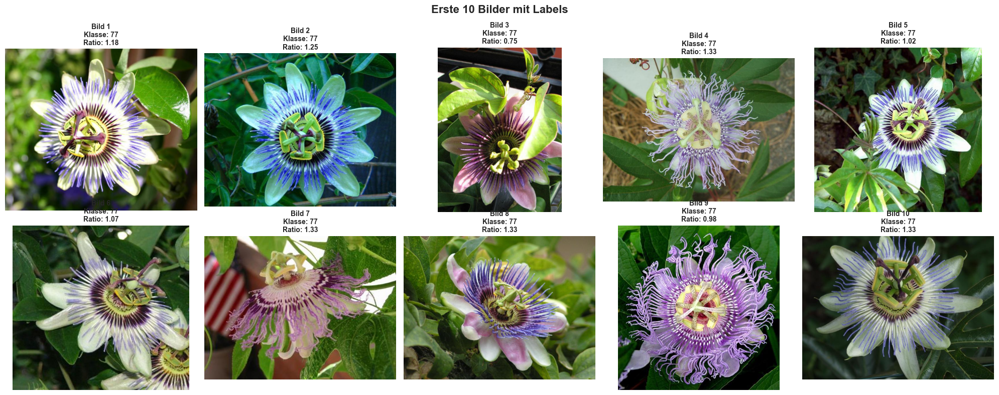

In [7]:
print("ERSTE 10 BILDER UND IHRE LABELS")

# Bilddateien laden
image_files = sorted([f for f in os.listdir(data_dir) if f.endswith(('.jpg', '.jpeg', '.png'))])

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle('Erste 10 Bilder mit Labels', fontsize=16, fontweight='bold')
axes = axes.flatten()

for i in range(min(10, len(image_files))):
    image_file = image_files[i]
    label = labels[i]
    
    print(f"\nBild {i+1}:")
    print(f"  Dateiname: {image_file}")
    print(f"  Label (Klasse): {label}")
    
    try:
        img = Image.open(os.path.join(data_dir, image_file))
        img_array = np.array(img)
        h, w, c = img_array.shape
        aspect_ratio = w / h
        
        print(f"  Dimensionen: {w}×{h}×{c} (Breite×Höhe×Kanäle)")
        print(f"  Seitenverhältnis: {aspect_ratio:.3f}")
        
        # Bild in Subplot
        axes[i].imshow(img_array)
        axes[i].set_title(f'Bild {i+1}\nKlasse: {label}\nRatio: {aspect_ratio:.2f}', 
                         fontsize=10, fontweight='bold')
        axes[i].axis('off')  # Achsen ausblenden
        
        axes[i].set_aspect('equal')
        
    except Exception as e:
        print(f"  Fehler beim Laden: {e}")
        axes[i].text(0.5, 0.5, f'Fehler\n{e}', 
                    ha='center', va='center', fontsize=10, color='red')
        axes[i].axis('off')

plt.tight_layout()
plt.show()


Analyse der Bilddimensionen:
   Breite  - Min:  500, Max: 1024, Mean:  630.2, Median:  667.0
   Höhe    - Min:  500, Max: 1168, Mean:  534.4, Median:  500.0
   Ratio   - Min: 0.428, Max: 2.048, Mean: 1.210, Median: 1.332

Ziel-Format: 224×224 (Ratio = 1.0)
Durchschnittliche Abweichung vom Ziel-Ratio: 0.310

Resize + Center Crop
1. Resize zur größeren Dimension (behält Ratio)
2. Center Crop auf 224×224 (entfernt Ränder gleichmäßig)

40 Beispiele: 20 random, 10 lowest resolution, 10 highest resolution (Vorher → Nachher):


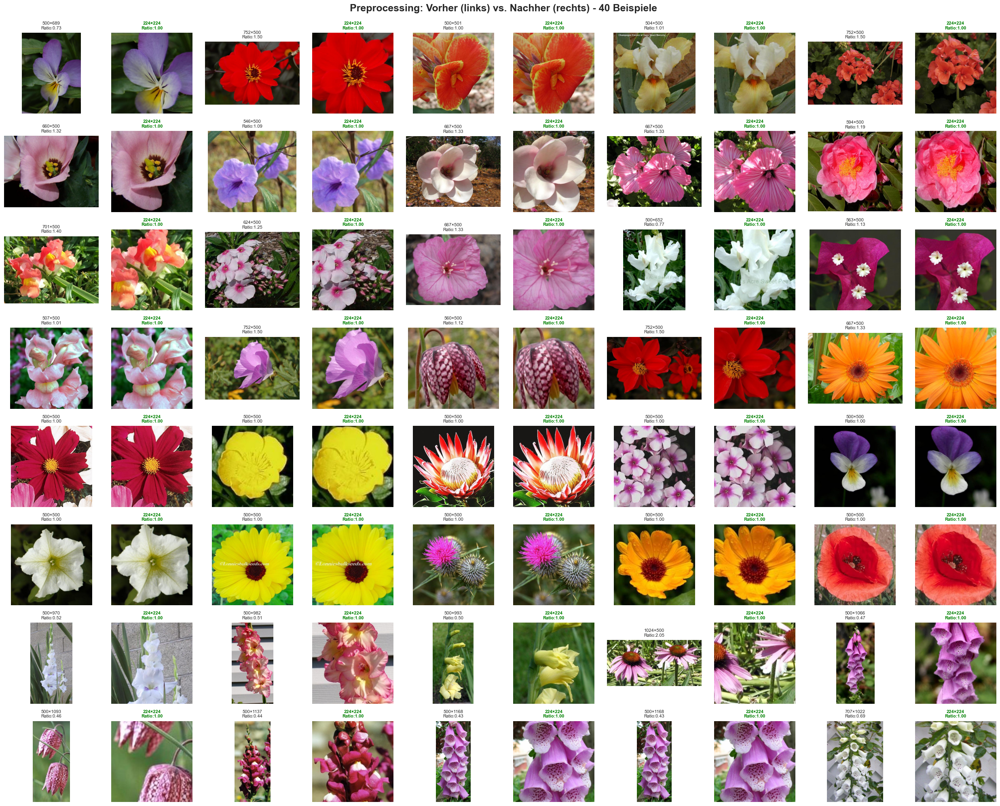

In [8]:
# Analyse der Bildgrößen und Seitenverhältnisse
print(f"\nAnalyse der Bilddimensionen:")
print(f"   Breite  - Min: {np.min(widths):4.0f}, Max: {np.max(widths):4.0f}, Mean: {np.mean(widths):6.1f}, Median: {np.median(widths):6.1f}")
print(f"   Höhe    - Min: {np.min(heights):4.0f}, Max: {np.max(heights):4.0f}, Mean: {np.mean(heights):6.1f}, Median: {np.median(heights):6.1f}")
print(f"   Ratio   - Min: {np.min(aspect_ratios):.3f}, Max: {np.max(aspect_ratios):.3f}, Mean: {np.mean(aspect_ratios):.3f}, Median: {np.median(aspect_ratios):.3f}")

# Seitenverhältnis - 1.0 für quadratische 224x224 Bilder
target_ratio = 1.0
ratio_diff = [abs(r - target_ratio) for r in aspect_ratios]
mean_ratio_diff = np.mean(ratio_diff)

print(f"\nZiel-Format: 224×224 (Ratio = 1.0)")
print(f"Durchschnittliche Abweichung vom Ziel-Ratio: {mean_ratio_diff:.3f}")

# basierend auf der Median-Ratio Analyse
print(f"\nResize + Center Crop")
print(f"1. Resize zur größeren Dimension (behält Ratio)")
print(f"2. Center Crop auf 224×224 (entfernt Ränder gleichmäßig)")

from torchvision import transforms

# Smart Transform: Resize + Center Crop
smart_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
])

# Wähle 20 Beispielbilder aus (aus allen Bildern)
all_indices = list(range(len(image_files)))
sample_indices = np.random.choice(all_indices, size=min(20, len(all_indices)), replace=False)
# 10 Beispielbilder aus niedrigsten Dimensionen
lowest_pixel_indices = np.argsort(pixel_counts)[:10]
# 10 Beispielbilder aus höchsten Dimensionen
highest_pixel_indices = np.argsort(pixel_counts)[-10:]

sample_indices = np.append(sample_indices,lowest_pixel_indices)
sample_indices = np.append(sample_indices,highest_pixel_indices)
print(f"\n40 Beispiele: 20 random, 10 lowest resolution, 10 highest resolution (Vorher → Nachher):")
fig, axes = plt.subplots(8, 10, figsize=(25, 20))
fig.suptitle('Preprocessing: Vorher (links) vs. Nachher (rechts) - 40 Beispiele', 
             fontsize=18, fontweight='bold', y=0.995)

for plot_idx, img_idx in enumerate(sample_indices):
    row = plot_idx // 5
    col_pair = plot_idx % 5
    
    image_file = image_files[img_idx]
    img_path = os.path.join(data_dir, image_file)
    
    try:
        img_original = Image.open(img_path).convert('RGB')
        original_array = np.array(img_original)
        
        # Transform anwenden
        img_processed = smart_transform(img_original)
        processed_array = np.array(img_processed)
        
        ax_before = axes[row, col_pair * 2]
        ax_before.imshow(original_array)
        ax_before.set_title(f'{widths[img_idx]}×{heights[img_idx]}\nRatio:{aspect_ratios[img_idx]:.2f}',
                           fontsize=8)
        ax_before.axis('off')
        
        ax_after = axes[row, col_pair * 2 + 1]
        ax_after.imshow(processed_array)
        ax_after.set_title(f'224×224\nRatio:1.00', fontsize=8, color='green', fontweight='bold')
        ax_after.axis('off')
        
    except Exception as e:
        print(f"Fehler bei Bild {img_idx}: {e}")

plt.tight_layout()
plt.show()


In [9]:
# Datentransformation für Training und Testing

from torchvision import transforms

# Train Transform mit Data Augmentation
train_transform = transforms.Compose([
    transforms.Resize(256),              # Resize kürzere Seite auf 256
    transforms.RandomCrop(224),          # Random Crop für Augmentation
    transforms.RandomHorizontalFlip(),   # Zufälliges horizontales Spiegeln
    transforms.RandomRotation(15),       # Zufällige Rotation ±15°
    transforms.ColorJitter(               # Farb-Augmentation
        brightness=0.2,
        contrast=0.2
    ),
    transforms.ToTensor(),               # Konvertiert zu Tensor [0, 1]
    transforms.Normalize(                # Normalisierung
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

# Test/Validation Transform (OHNE Augmentation)
test_transform = transforms.Compose([
    transforms.Resize(256),              # Resize kürzere Seite auf 256
    transforms.CenterCrop(224),          # Center Crop 
    transforms.ToTensor(),               # Konvertiert zu Tensor [0, 1]
    transforms.Normalize(                # Normalisierung
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

print("Datentransformation")
print("\n Train Transform (mit Data Augmentation):")
print("  1. Resize(256) - Kürzere Seite auf 256")
print("  2. RandomCrop(224) - Zufälliger Crop für Variation")
print("  3. RandomHorizontalFlip() - 50% Chance horizontal spiegeln")
print("  4. RandomRotation(15) - Rotation ±15°")
print("  5. ColorJitter - Farb-Variation (Kontrast, Helligkeit)")
print("  6. ToTensor() - Konvertiert zu PyTorch Tensor")
print("  7. Normalize() - Standardisierung")
print("\n Test/Validation Transform (ohne Augmentation):")
print("  1. Resize(256) - Kürzere Seite auf 256")
print("  2. CenterCrop(224) - Center Crop")
print("  3. ToTensor() - Konvertiert zu PyTorch Tensor")
print("  4. Normalize() - Standardisierung")


Datentransformation

 Train Transform (mit Data Augmentation):
  1. Resize(256) - Kürzere Seite auf 256
  2. RandomCrop(224) - Zufälliger Crop für Variation
  3. RandomHorizontalFlip() - 50% Chance horizontal spiegeln
  4. RandomRotation(15) - Rotation ±15°
  5. ColorJitter - Farb-Variation (Kontrast, Helligkeit)
  6. ToTensor() - Konvertiert zu PyTorch Tensor
  7. Normalize() - Standardisierung

 Test/Validation Transform (ohne Augmentation):
  1. Resize(256) - Kürzere Seite auf 256
  2. CenterCrop(224) - Center Crop
  3. ToTensor() - Konvertiert zu PyTorch Tensor
  4. Normalize() - Standardisierung


In [10]:
# Split dataset into train, validation, and test sets
indices = np.arange(len(labels))

# First split: 80% train, 20% temp (for val+test) (so 80% and 10% + 10%)
train_indices, temp_indices = train_test_split(
    indices, test_size=0.2, random_state=42, stratify=labels
)

# Second split: split temp into 50% val, 50% test (10% each of total)
temp_labels = labels[temp_indices]
val_indices, test_indices = train_test_split(
    temp_indices, test_size=0.5, random_state=42, stratify=temp_labels
)

print(f"Train set size: {len(train_indices)}")
print(f"Validation set size: {len(val_indices)}")
print(f"Test set size: {len(test_indices)}")


Train set size: 6551
Validation set size: 819
Test set size: 819


In [11]:
# Create dataset instances
train_dataset = FlowersDataset(data_dir, labels, train_indices, transform=train_transform)
val_dataset = FlowersDataset(data_dir, labels, val_indices, transform=test_transform)
test_dataset = FlowersDataset(data_dir, labels, test_indices, transform=test_transform)

# Create data loaders
batch_size = 32

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

print(f"Number of batches - Train: {len(train_loader)}, Val: {len(val_loader)}, Test: {len(test_loader)}")


Number of batches - Train: 205, Val: 26, Test: 26


# Own Flower CNN Model
doppelten 3×3-Convs pro Stufe (64→128→256→512)

BatchNorm

FC-Head (512→1024→256→102)

In [12]:
import torch
import torch.nn as nn

# Own CNN Model
class FlowerCNNModel(nn.Module):
    def __init__(self, num_classes=102):
        super().__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),

            nn.Conv2d(64, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            nn.Conv2d(64, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.Conv2d(128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            nn.Conv2d(128, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),

            nn.Conv2d(256, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            nn.Conv2d(256, 512, 3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),

            nn.Conv2d(512, 512, 3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
        )
        self.pool = nn.AdaptiveAvgPool2d((1, 1))
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(512, 1024),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(1024, 256),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(256, num_classes),
        )

    def forward(self, x):
        x = self.features(x)
        x = self.pool(x)
        x = self.classifier(x)
        return x

# Parameteranzahl
model_param = FlowerCNNModel(num_classes=102).to(device)
total_params = sum(p.numel() for p in model_param.parameters())
trainable_params = sum(p.numel() for p in model_param.parameters() if p.requires_grad)
print(f"Gesamtparameter (wide): {total_params:,}")
print(f"Trainierbare Parameter (wide): {trainable_params:,}")

Gesamtparameter (wide): 5,503,142
Trainierbare Parameter (wide): 5,503,142


In [13]:

# Gewichtung der Klassen für unbalancierte Datensätze
def compute_class_weights(labels, indices, num_classes):
    fold_labels = labels[indices] - 1  # 0–101
    class_counts = np.bincount(fold_labels, minlength=num_classes)

    total_samples = class_counts.sum()
    class_weights = total_samples / (num_classes * class_counts)

    return torch.tensor(class_weights, dtype=torch.float32)


In [14]:

# Train & Eval Funktionen
def train_one_epoch(model, loader, optimizer, criterion, device):
    model.train()
    correct, total, loss_sum = 0, 0, 0

    for images, labels in loader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        loss_sum += loss.item()
        _, preds = outputs.max(1)
        total += labels.size(0)
        correct += preds.eq(labels).sum().item()

    return loss_sum / len(loader), 100. * correct / total


def evaluate(model, loader, criterion, device, return_predictions=False):
    model.eval()
    correct, total, loss_sum = 0, 0, 0
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)

            loss_sum += loss.item()
            _, preds = outputs.max(1)
            total += labels.size(0)
            correct += preds.eq(labels).sum().item()
            
            if return_predictions:
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

    acc = 100. * correct / total
    if return_predictions:
        return loss_sum / len(loader), acc, all_preds, all_labels
    return loss_sum / len(loader), acc


In [15]:
# Modell Beschreibung
def describe_model(model, model_name="Model"):
    """
    Zeigt detaillierte Informationen über das Modell an
    """
    print(f"\n{'='*80}")
    print(f"{model_name.upper()} - ARCHITECTURE SUMMARY")
    print(f"{'='*80}")
    
    print(model)
    
    print(f"\n{'='*80}")
    print(f"PARAMETER SUMMARY")
    print(f"{'='*80}")
    
    # Parameter zählen
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    non_trainable_params = total_params - trainable_params
    
    print(f"Total Parameters:        {total_params:,}")
    print(f"Trainable Parameters:    {trainable_params:,}")
    print(f"Non-Trainable Parameters: {non_trainable_params:,}")
    
    # Speicher-Schätzung (in MB)
    param_size_mb = total_params * 4 / (1024**2)  # Float32 = 4 bytes
    print(f"\nEstimated Model Size:    {param_size_mb:.2f} MB")
    
    # Layer-wise Parameter Count
    print(f"\n{'='*80}")
    print(f"LAYER-WISE PARAMETER COUNT")
    print(f"{'='*80}")
    print(f"{'Layer Name':<50} {'Parameters':>15} {'Trainable':>10}")
    print(f"{'-'*80}")
    
    for name, param in model.named_parameters():
        trainable = "Yes" if param.requires_grad else "No"
        print(f"{name:<50} {param.numel():>15,} {trainable:>10}")
    
    print(f"{'='*80}\n")


# Modell 1: Custom CNN (ohne Data Augmentation)


========== Fold 1/5 ==========

CUSTOM CNN (OHNE AUGMENTATION) - ARCHITECTURE SUMMARY
FlowerCNNModel(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): Ma

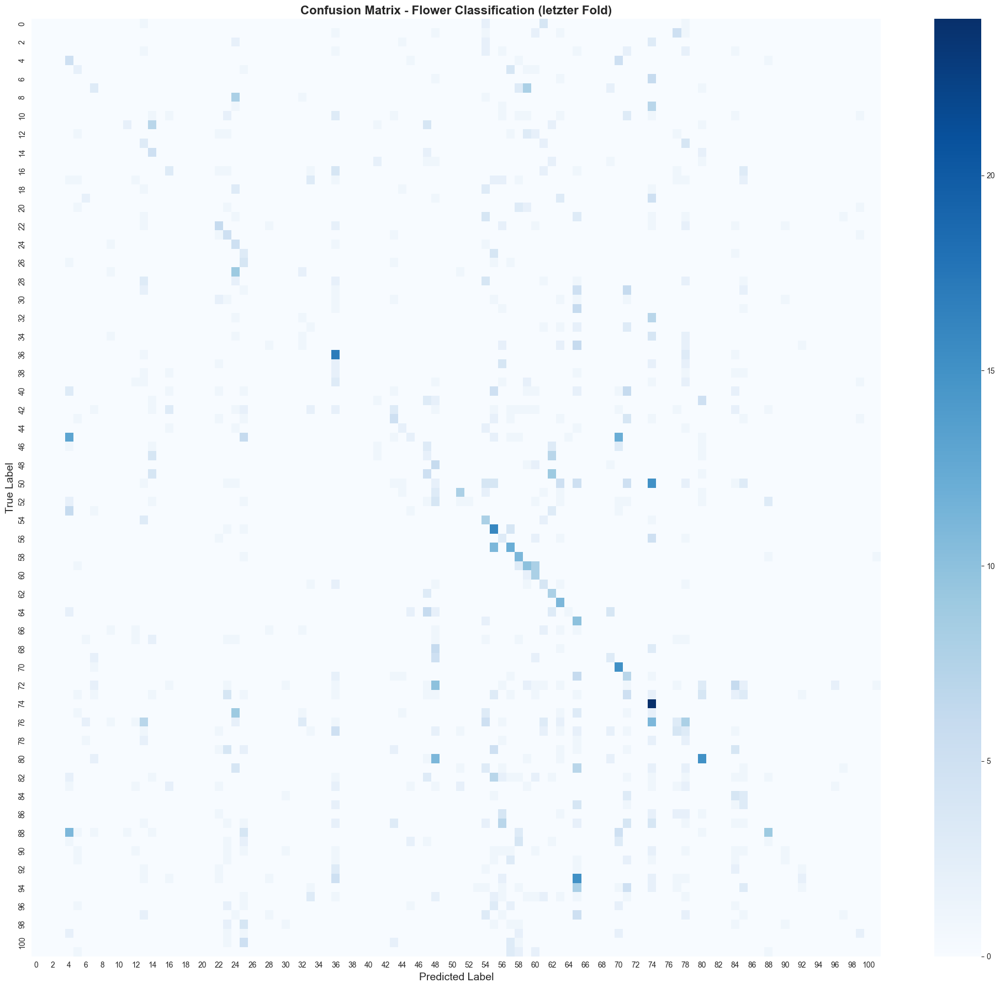

In [16]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix
import seaborn as sns
import time

# Transformation (nur ToTensor)
basic_transform_customcnn = transforms.Compose([
    transforms.Resize(256),              # Resize kürzere Seite auf 256
    transforms.CenterCrop(224),          # Center Crop (wie smart_transform)
    transforms.ToTensor(),               # Konvertiert zu Tensor [0, 1]
    transforms.Normalize(                # ImageNet-Normalisierung
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

# Stratified K-Fold
k_folds = 5
epochs = 10
batch_size = 32

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
y = labels - 1  # 0–101

skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=1)
indices = np.arange(len(labels))
fold_accuracies = []
fold_f1_scores = []
fold_train_losses_m1 = []
fold_val_losses_m1 = []
fold_train_accs_m1 = []
fold_val_accs_m1 = []

# Zeitmessung starten
train_start_time_model1 = time.time()

# Cross-Validation Loop
for fold, (train_idx, test_idx) in enumerate(skf.split(indices, y)):
    print(f"\n========== Fold {fold + 1}/{k_folds} ==========")

    train_dataset = FlowersDataset(
        data_dir, labels, train_idx, basic_transform_customcnn
    )
    test_dataset = FlowersDataset(
        data_dir, labels, test_idx, basic_transform_customcnn
    )

    assert len(train_dataset) > 0, "Train dataset is empty!"
    assert len(test_dataset) > 0, "Test dataset is empty!"

    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=0,
        pin_memory=True
    )

    model = FlowerCNNModel(num_classes=102).to(device)
    
    # Modell-Beschreibung (nur beim ersten Fold)
    if fold == 0:
        describe_model(model, "Custom CNN (ohne Augmentation)")
    
    class_weights = compute_class_weights(
        labels, train_idx, num_classes=102
    ).to(device)
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    for epoch in range(epochs):
        train_loss, train_acc = train_one_epoch(
            model, train_loader, optimizer, criterion, device
        )
        
        test_loss, test_acc = evaluate(
            model, test_loader, criterion, device
        )
        
        # Store history
        fold_train_losses_m1.append(train_loss)
        fold_val_losses_m1.append(test_loss)
        fold_train_accs_m1.append(train_acc)
        fold_val_accs_m1.append(test_acc)

        print(
            f"Epoch [{epoch+1}/{epochs}] | "
            f"Train Acc: {train_acc:.2f}% | "
            f"Val Acc: {test_acc:.2f}%"
        )

    # Finale Evaluation mit Predictions
    test_loss, test_acc, preds, true_labels = evaluate(
        model, test_loader, criterion, device, return_predictions=True
    )
    
    # F1-Score berechnen
    f1_macro = f1_score(true_labels, preds, average='macro')
    f1_weighted = f1_score(true_labels, preds, average='weighted')

    print(f"Test Accuracy Fold {fold + 1}: {test_acc:.2f}%")
    print(f"F1-Score (macro): {f1_macro:.4f}")
    print(f"F1-Score (weighted): {f1_weighted:.4f}")
    
    fold_accuracies.append(test_acc)
    fold_f1_scores.append(f1_macro)

# Zeitmessung beenden
train_end_time_model1 = time.time()
train_duration_model1 = train_end_time_model1 - train_start_time_model1

# Ergebnisse
fold_accuracies = np.array(fold_accuracies)
fold_f1_scores = np.array(fold_f1_scores)

print("\n===== Stratified K-Fold Results =====")
print(f"Fold Accuracies: {fold_accuracies}")
print(f"Mean Accuracy: {fold_accuracies.mean():.2f}%")
print(f"Std Deviation: {fold_accuracies.std():.2f}%")
print(f"\nFold F1-Scores (macro): {fold_f1_scores}")
print(f"Mean F1-Score: {fold_f1_scores.mean():.4f}")
print(f"Std Deviation: {fold_f1_scores.std():.4f}")
print(f"\nTraining Duration: {train_duration_model1/60:.2f} minutes ({train_duration_model1:.2f} seconds)")

# Speichere Ergebnisse für Vergleich
results_model1 = {
    'name': 'Custom CNN (ohne Augmentation)',
    'mean_accuracy': fold_accuracies.mean(),
    'std_accuracy': fold_accuracies.std(),
    'mean_f1': fold_f1_scores.mean(),
    'std_f1': fold_f1_scores.std(),
    'duration': train_duration_model1
}

# Confusion Matrix für letzten Fold
print("\n===== Confusion Matrix (letzter Fold) =====")
cm1 = confusion_matrix(true_labels, preds)
plt.figure(figsize=(20, 18))
sns.heatmap(cm1, annot=False, fmt='d', cmap='Blues', cbar=True)
plt.title('Confusion Matrix - Flower Classification (letzter Fold)', fontsize=16, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.tight_layout()
plt.show()

Total epochs: 50
Epochs per fold: 10
Number of folds: 5


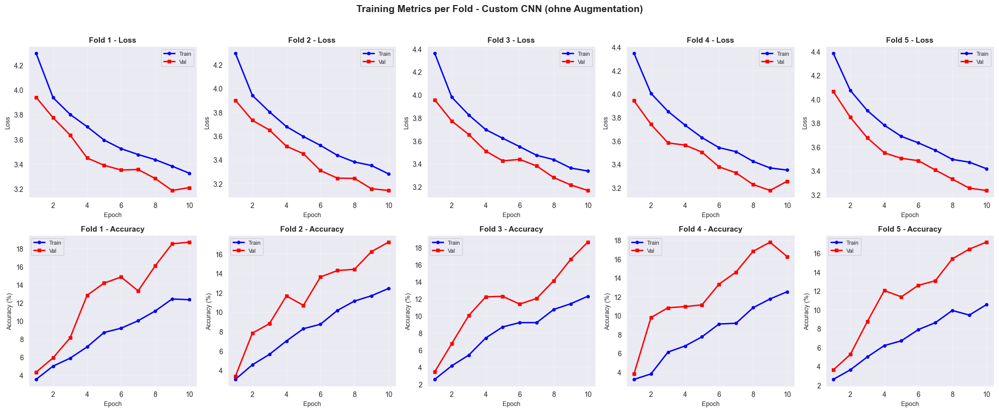

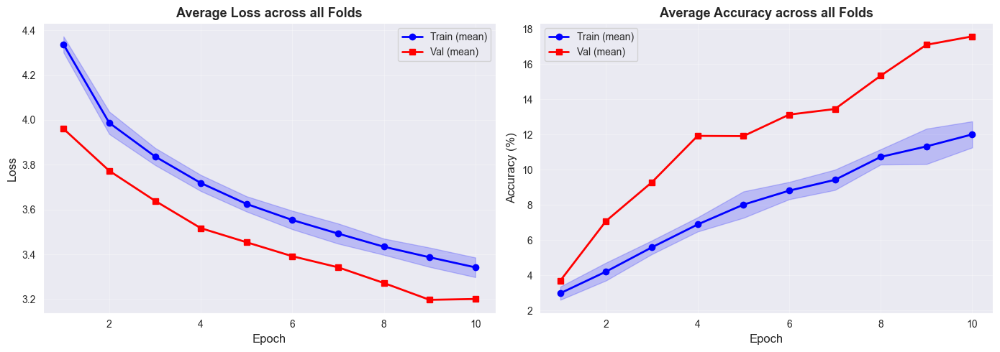

In [17]:
# ========================
# LOSS UND ACCURACY PLOTS - MODELL 1
# ========================
import matplotlib.pyplot as plt
import numpy as np

# Berechne Epochen pro Fold
epochs_per_fold = len(fold_train_losses_m1) // k_folds

print(f"Total epochs: {len(fold_train_losses_m1)}")
print(f"Epochs per fold: {epochs_per_fold}")
print(f"Number of folds: {k_folds}")

# Erstelle Figure mit Subplots für jeden Fold
fig, axes = plt.subplots(2, k_folds, figsize=(20, 8))

for fold in range(k_folds):
    start_idx = fold * epochs_per_fold
    end_idx = (fold + 1) * epochs_per_fold
    
    fold_epochs = range(1, epochs_per_fold + 1)
    fold_train_loss = fold_train_losses_m1[start_idx:end_idx]
    fold_val_loss = fold_val_losses_m1[start_idx:end_idx]
    fold_train_acc = fold_train_accs_m1[start_idx:end_idx]
    fold_val_acc = fold_val_accs_m1[start_idx:end_idx]
    
    # Loss Plot
    axes[0, fold].plot(fold_epochs, fold_train_loss, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[0, fold].plot(fold_epochs, fold_val_loss, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[0, fold].set_title(f'Fold {fold + 1} - Loss', fontsize=11, fontweight='bold')
    axes[0, fold].set_xlabel('Epoch', fontsize=9)
    axes[0, fold].set_ylabel('Loss', fontsize=9)
    axes[0, fold].legend(fontsize=8)
    axes[0, fold].grid(True, alpha=0.3)
    
    # Accuracy Plot
    axes[1, fold].plot(fold_epochs, fold_train_acc, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[1, fold].plot(fold_epochs, fold_val_acc, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[1, fold].set_title(f'Fold {fold + 1} - Accuracy', fontsize=11, fontweight='bold')
    axes[1, fold].set_xlabel('Epoch', fontsize=9)
    axes[1, fold].set_ylabel('Accuracy (%)', fontsize=9)
    axes[1, fold].legend(fontsize=8)
    axes[1, fold].grid(True, alpha=0.3)

plt.suptitle('Training Metrics per Fold - Custom CNN (ohne Augmentation)', fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# Durchschnittlicher Verlauf über alle Folds
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Reshape losses zu (k_folds, epochs_per_fold)
train_losses_reshaped = np.array(fold_train_losses_m1).reshape(k_folds, epochs_per_fold)
val_losses_reshaped = np.array(fold_val_losses_m1).reshape(k_folds, epochs_per_fold)
train_accs_reshaped = np.array(fold_train_accs_m1).reshape(k_folds, epochs_per_fold)
val_accs_reshaped = np.array(fold_val_accs_m1).reshape(k_folds, epochs_per_fold)

# Durchschnitt und Standardabweichung
mean_train_loss = train_losses_reshaped.mean(axis=0)
std_train_loss = train_losses_reshaped.std(axis=0)
mean_val_loss = val_losses_reshaped.mean(axis=0)
std_val_loss = val_losses_reshaped.std(axis=0)

mean_train_acc = train_accs_reshaped.mean(axis=0)
std_train_acc = train_accs_reshaped.std(axis=0)
mean_val_acc = val_accs_reshaped.mean(axis=0)
std_val_acc = val_accs_reshaped.std(axis=0)

epochs = range(1, epochs_per_fold + 1)

# Average Loss Plot mit Konfidenzintervall
ax1.plot(epochs, mean_train_loss, 'b-o', label='Train (mean)', linewidth=2)
ax1.fill_between(epochs, mean_train_loss - std_train_loss, mean_train_loss + std_train_loss, alpha=0.2, color='blue')
ax1.plot(epochs, mean_val_loss, 'r-s', label='Val (mean)', linewidth=2)
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.set_title('Average Loss across all Folds', fontsize=13, fontweight='bold')
ax1.legend(fontsize=10)
ax1.grid(True, alpha=0.3)

# Average Accuracy Plot mit Konfidenzintervall
ax2.plot(epochs, mean_train_acc, 'b-o', label='Train (mean)', linewidth=2)
ax2.fill_between(epochs, mean_train_acc - std_train_acc, mean_train_acc + std_train_acc, alpha=0.2, color='blue')
ax2.plot(epochs, mean_val_acc, 'r-s', label='Val (mean)', linewidth=2)
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Accuracy (%)', fontsize=12)
ax2.set_title('Average Accuracy across all Folds', fontsize=13, fontweight='bold')
ax2.legend(fontsize=10)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Modell 2: ResNet18 mit Transfer Learning und Data Augmentation

-----
Erweiterung bestehendes Training für bessere Accuracy/schnelleres Training
-----
- Augmentation
- Transfer Learning
- Early Stopping 


In [18]:
from torchvision import models

def create_resnet_model(num_classes=102):
    model = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
    
    # zuerst alles einfrieren
    for param in model.parameters():
        param.requires_grad = False

    # layer 4 trainieren (ca 75% aller Parameter)
    # for param in model.layer4.parameters():
    #     param.requires_grad = True

    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, num_classes)

    # nur fc Layer trainieren
    for param in model.fc.parameters():
        param.requires_grad = True
    
    return model


In [19]:

# Early Stopping Implementation
class EarlyStopping:
    def __init__(self, patience=5, verbose=False, delta=0.001):
        self.patience = patience
        self.verbose = verbose
        self.delta = delta
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.inf

    def __call__(self, val_loss):
        if self.best_score is None:
            self.best_score = val_loss
        elif val_loss > self.best_score - self.delta:
            self.counter += 1
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter}/{self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = val_loss
            self.counter = 0
        
        return self.early_stop



========== Fold 1/5 ==========
Train: 6551 | Test: 1638

RESNET18 (WITH AUGMENTATION) - ARCHITECTURE SUMMARY
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): Batch

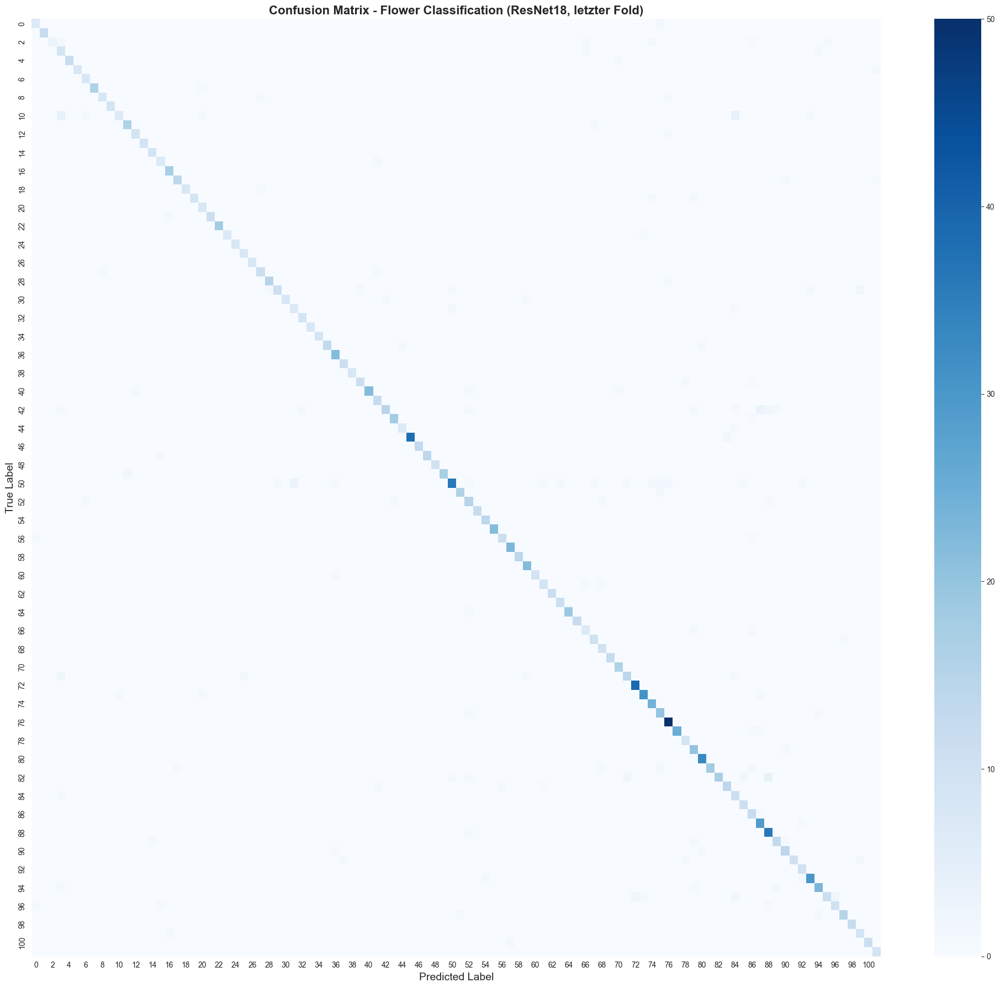

In [20]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix
import seaborn as sns
import time

k_folds = 5
epochs = 10
patience_early_stop = 2
batch_size = 32

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
y = labels - 1  # 0–101

skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
indices = np.arange(len(labels))
fold_accuracies_enhanced = []
fold_best_accs = []
fold_f1_scores_enhanced = []
fold_train_losses_m2 = []
fold_val_losses_m2 = []
fold_train_accs_m2 = []
fold_val_accs_m2 = []

# Zeitmessung starten
train_start_time_model2 = time.time()

# Cross-Validation Loop
for fold, (train_idx, test_idx) in enumerate(skf.split(indices, y)):
    print(f"\n========== Fold {fold + 1}/{k_folds} ==========")
    print(f"Train: {len(train_idx)} | Test: {len(test_idx)}")
    
    train_dataset_fold = FlowersDataset(
        data_dir, labels, train_idx, train_transform
    )
    test_dataset_fold = FlowersDataset(
        data_dir, labels, test_idx, test_transform
    )

    assert len(train_dataset_fold) > 0, "Train dataset is empty!"
    assert len(test_dataset_fold) > 0, "Test dataset is empty!"

    train_loader = DataLoader(
        train_dataset_fold,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    test_loader = DataLoader(
        test_dataset_fold,
        batch_size=batch_size,
        shuffle=False,
        num_workers=0,
        pin_memory=True
    )

    # Initialize ResNet18 model (fresh for each fold)
    model_resnet = create_resnet_model(num_classes=102).to(device)
    
    # Modell-Beschreibung (nur beim ersten Fold)
    if fold == 0:
        describe_model(model_resnet, "ResNet18 (with Augmentation)")
    
    class_weights = compute_class_weights(
        labels, train_idx, num_classes=102
    ).to(device)
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model_resnet.parameters(), lr=1e-3)
    
    # Early stopping
    # early_stopping_fold = EarlyStopping(patience=patience_early_stop, verbose=False, delta=0.001)

    best_fold_acc = 0.0
    last_test_acc = 0.0

    for epoch in range(epochs):
        train_loss, train_acc = train_one_epoch(
            model_resnet, train_loader, optimizer, criterion, device
        )
            
        test_loss, test_acc = evaluate(
            model_resnet, test_loader, criterion, device
        )
        
        # Keep last test accuracy for fold summary
        last_test_acc = test_acc

        # Store history
        fold_train_losses_m2.append(train_loss)
        fold_val_losses_m2.append(test_loss)
        fold_train_accs_m2.append(train_acc)
        fold_val_accs_m2.append(test_acc)

        print(f"Epoch: {epoch+1} Train Loss: {train_loss:.4f} Train Acc: {train_acc:.2f}% Test Loss: {test_loss:.4f} Test Acc: {test_acc:.2f}%")
        
        # Save best model
        if test_acc > best_fold_acc:
            best_fold_acc = test_acc
        
        # Early Stopping check
        # if early_stopping_fold(test_loss):
        #     print(f"Early Stopping at epoch {epoch+1}")
        #     break 
    
    # Finale Evaluation mit Predictions für F1-Score und Confusion Matrix
    _, final_acc, preds, true_labels = evaluate(
        model_resnet, test_loader, criterion, device, return_predictions=True
    )
    
    # F1-Score berechnen
    f1_macro = f1_score(true_labels, preds, average='macro')
    f1_weighted = f1_score(true_labels, preds, average='weighted')
    
    print(f"Fold {fold + 1} completed")
    print(f"Best Test Accuracy: {best_fold_acc:.2f}%")
    print(f"F1-Score (macro): {f1_macro:.4f}")
    print(f"F1-Score (weighted): {f1_weighted:.4f}")
    
    fold_accuracies_enhanced.append(last_test_acc)
    fold_best_accs.append(best_fold_acc)
    fold_f1_scores_enhanced.append(f1_macro)

# Zeitmessung beenden
train_end_time_model2 = time.time()
train_duration_model2 = train_end_time_model2 - train_start_time_model2

# Ergebnisse
fold_accuracies_enhanced = np.array(fold_accuracies_enhanced)
fold_best_accs = np.array(fold_best_accs)
fold_f1_scores_enhanced = np.array(fold_f1_scores_enhanced)


print("\n===== Enhanced K-Fold Results (with Augmentation) =====")
print(f"Fold Accuracies:     {fold_accuracies_enhanced}")
print(f"Best Fold Accuracies:      {fold_best_accs}")
print(f"\nMean Accuracy:        {fold_accuracies_enhanced.mean():.2f}%")
print(f"Std Deviation:      {fold_accuracies_enhanced.std():.2f}%")
print(f"\nMean Best Accuracy:        {fold_best_accs.mean():.2f}%")
print(f"Std Deviation (Best):      {fold_best_accs.std():.2f}%")
print(f"\nFold F1-Scores (macro):    {fold_f1_scores_enhanced}")
print(f"Mean F1-Score:             {fold_f1_scores_enhanced.mean():.4f}")
print(f"Std Deviation (F1):        {fold_f1_scores_enhanced.std():.4f}")
print(f"\nTraining Duration: {train_duration_model2/60:.2f} minutes ({train_duration_model2:.2f} seconds)")

# Speichere Ergebnisse für Vergleich
results_model4 = {
    'name': 'ResNet18 (with Augmentation)',
    'mean_accuracy': fold_accuracies_enhanced.mean(),
    'std_accuracy': fold_accuracies_enhanced.std(),
    'mean_f1': fold_f1_scores_enhanced.mean(),
    'std_f1': fold_f1_scores_enhanced.std(),
    'duration': train_duration_model2
}

# Confusion Matrix für letzten Fold
print("\n===== Confusion Matrix (letzter Fold - ResNet18) =====")
cm4 = confusion_matrix(true_labels, preds)
plt.figure(figsize=(20, 18))
sns.heatmap(cm4, annot=False, fmt='d', cmap='Blues', cbar=True)
plt.title('Confusion Matrix - Flower Classification (ResNet18, letzter Fold)', fontsize=16, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=14)

plt.ylabel('True Label', fontsize=14)

plt.tight_layout()
plt.show()

Total epochs: 50
Epochs per fold: 10
Number of folds: 5


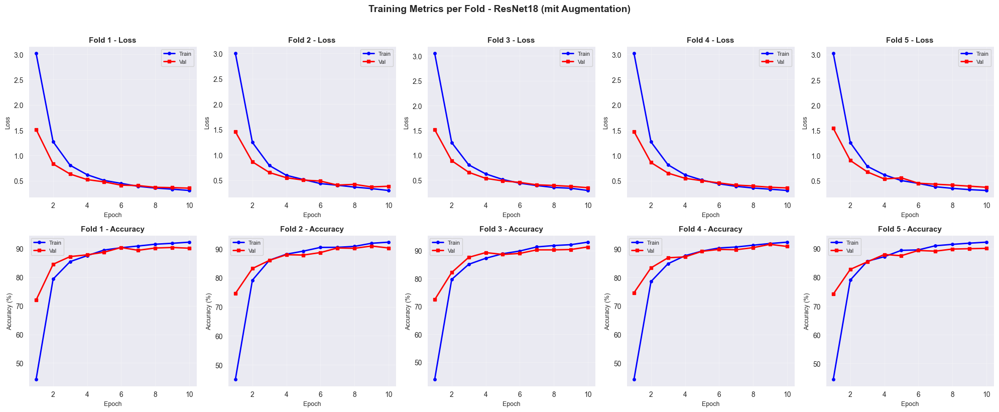

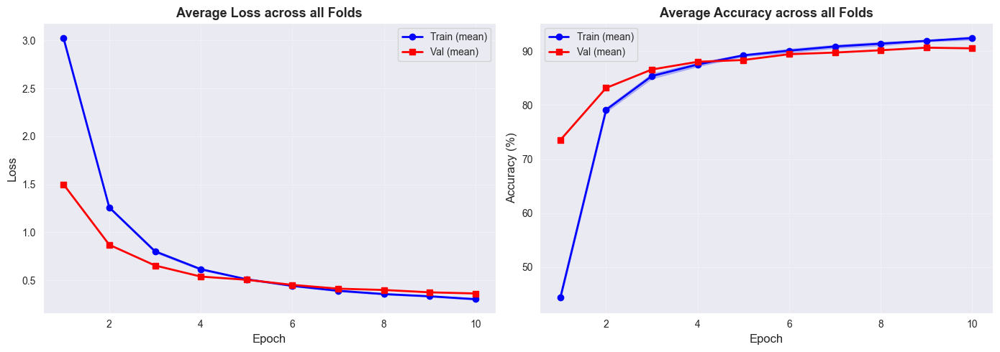

In [21]:
# ========================
# LOSS UND ACCURACY PLOTS
# ========================
import matplotlib.pyplot as plt
import numpy as np

# Berechne Epochen pro Fold
epochs_per_fold = len(fold_train_losses_m2) // k_folds

print(f"Total epochs: {len(fold_train_losses_m2)}")
print(f"Epochs per fold: {epochs_per_fold}")
print(f"Number of folds: {k_folds}")

# Erstelle Figure mit Subplots für jeden Fold
fig, axes = plt.subplots(2, k_folds, figsize=(20, 8))

for fold in range(k_folds):
    start_idx = fold * epochs_per_fold
    end_idx = (fold + 1) * epochs_per_fold
    
    fold_epochs = range(1, epochs_per_fold + 1)
    fold_train_loss = fold_train_losses_m2[start_idx:end_idx]
    fold_val_loss = fold_val_losses_m2[start_idx:end_idx]
    fold_train_acc = fold_train_accs_m2[start_idx:end_idx]
    fold_val_acc = fold_val_accs_m2[start_idx:end_idx]
    
    # Loss Plot
    axes[0, fold].plot(fold_epochs, fold_train_loss, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[0, fold].plot(fold_epochs, fold_val_loss, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[0, fold].set_title(f'Fold {fold + 1} - Loss', fontsize=11, fontweight='bold')
    axes[0, fold].set_xlabel('Epoch', fontsize=9)
    axes[0, fold].set_ylabel('Loss', fontsize=9)
    axes[0, fold].legend(fontsize=8)
    axes[0, fold].grid(True, alpha=0.3)
    
    # Accuracy Plot
    axes[1, fold].plot(fold_epochs, fold_train_acc, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[1, fold].plot(fold_epochs, fold_val_acc, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[1, fold].set_title(f'Fold {fold + 1} - Accuracy', fontsize=11, fontweight='bold')
    axes[1, fold].set_xlabel('Epoch', fontsize=9)
    axes[1, fold].set_ylabel('Accuracy (%)', fontsize=9)
    axes[1, fold].legend(fontsize=8)
    axes[1, fold].grid(True, alpha=0.3)

plt.suptitle('Training Metrics per Fold - ResNet18 (mit Augmentation)', fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# Durchschnittlicher Verlauf über alle Folds
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Reshape losses zu (k_folds, epochs_per_fold)
train_losses_reshaped = np.array(fold_train_losses_m2).reshape(k_folds, epochs_per_fold)
val_losses_reshaped = np.array(fold_val_losses_m2).reshape(k_folds, epochs_per_fold)
train_accs_reshaped = np.array(fold_train_accs_m2).reshape(k_folds, epochs_per_fold)
val_accs_reshaped = np.array(fold_val_accs_m2).reshape(k_folds, epochs_per_fold)

# Durchschnitt und Standardabweichung
mean_train_loss = train_losses_reshaped.mean(axis=0)
std_train_loss = train_losses_reshaped.std(axis=0)
mean_val_loss = val_losses_reshaped.mean(axis=0)
std_val_loss = val_losses_reshaped.std(axis=0)

mean_train_acc = train_accs_reshaped.mean(axis=0)
std_train_acc = train_accs_reshaped.std(axis=0)
mean_val_acc = val_accs_reshaped.mean(axis=0)
std_val_acc = val_accs_reshaped.std(axis=0)

epochs = range(1, epochs_per_fold + 1)

# Average Loss Plot mit Konfidenzintervall
ax1.plot(epochs, mean_train_loss, 'b-o', label='Train (mean)', linewidth=2)
ax1.fill_between(epochs, mean_train_loss - std_train_loss, mean_train_loss + std_train_loss, alpha=0.2, color='blue')
ax1.plot(epochs, mean_val_loss, 'r-s', label='Val (mean)', linewidth=2)
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.set_title('Average Loss across all Folds', fontsize=13, fontweight='bold')
ax1.legend(fontsize=10)
ax1.grid(True, alpha=0.3)

# Average Accuracy Plot mit Konfidenzintervall
ax2.plot(epochs, mean_train_acc, 'b-o', label='Train (mean)', linewidth=2)
ax2.fill_between(epochs, mean_train_acc - std_train_acc, mean_train_acc + std_train_acc, alpha=0.2, color='blue')
ax2.plot(epochs, mean_val_acc, 'r-s', label='Val (mean)', linewidth=2)
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Accuracy (%)', fontsize=12)
ax2.set_title('Average Accuracy across all Folds', fontsize=13, fontweight='bold')
ax2.legend(fontsize=10)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Modell 3:  Eigenes Modell mit Data Augmentation


========== Fold 1/5 ==========

CUSTOM CNN (MIT AUGMENTATION) - ARCHITECTURE SUMMARY
FlowerCNNModel(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): Max

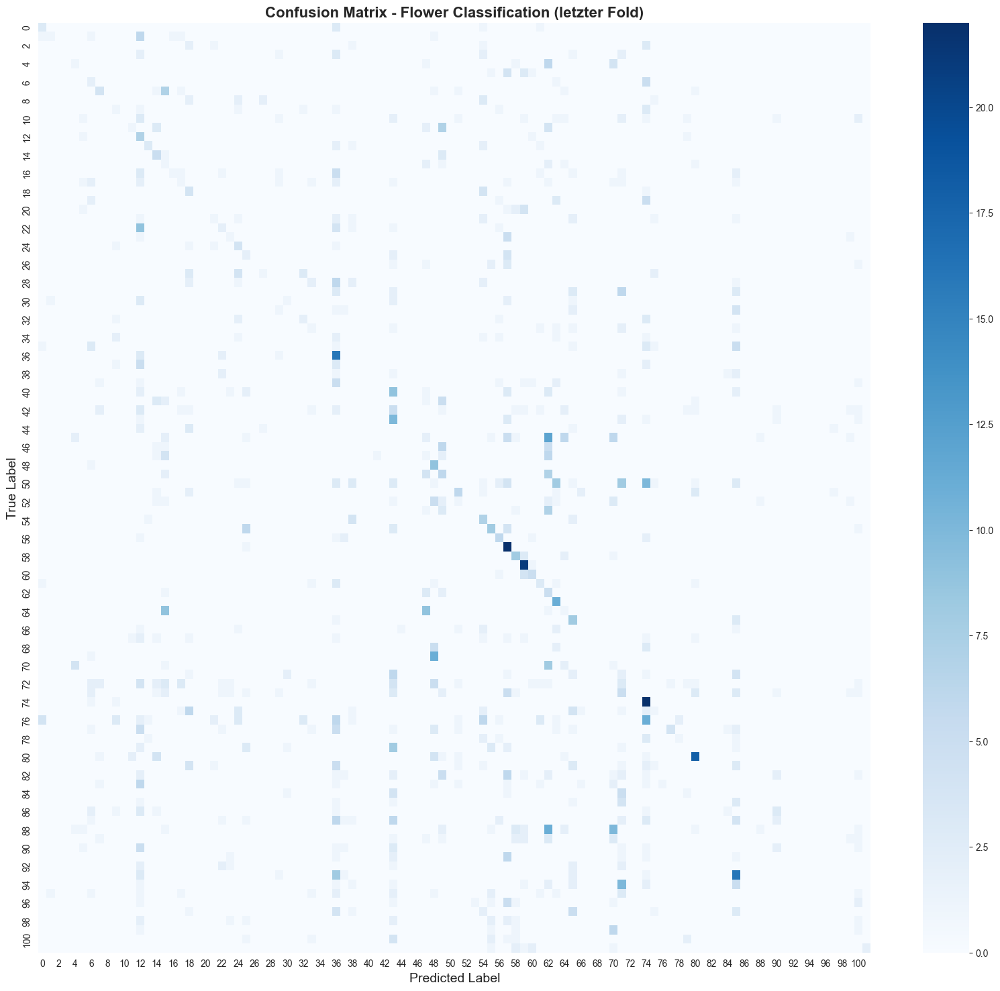

<Figure size 640x480 with 0 Axes>

In [22]:
# ==================================
# OWN MODEL WITH DATA AUGMENTATION
# ==================================

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix
import seaborn as sns
import time

# Stratified K-Fold
k_folds = 5
epochs = 10
batch_size = 32

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
y = labels - 1  # 0–101

skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=1)
indices = np.arange(len(labels))
fold_accuracies_augmented = []
fold_f1_scores_augmented = []
fold_train_losses_m3 = []
fold_val_losses_m3 = []
fold_train_accs_m3 = []
fold_val_accs_m3 = []

# Zeitmessung starten
train_start_time_model3 = time.time()

# Cross-Validation Loop
for fold, (train_idx, test_idx) in enumerate(skf.split(indices, y)):
    print(f"\n========== Fold {fold + 1}/{k_folds} ==========")

    train_dataset = FlowersDataset(
        data_dir, labels, train_idx, train_transform
    )
    test_dataset = FlowersDataset(
        data_dir, labels, test_idx, test_transform
    )

    assert len(train_dataset) > 0, "Train dataset is empty!"
    assert len(test_dataset) > 0, "Test dataset is empty!"

    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=0,
        pin_memory=True
    )

    model = FlowerCNNModel(num_classes=102).to(device)
    
    # Modell-Beschreibung (nur beim ersten Fold)
    if fold == 0:
        describe_model(model, "Custom CNN (mit Augmentation)")
    
    class_weights = compute_class_weights(
        labels, train_idx, num_classes=102
    ).to(device)
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    for epoch in range(epochs):
        train_loss, train_acc = train_one_epoch(
            model, train_loader, optimizer, criterion, device
        )
        
        test_loss, test_acc = evaluate(
            model, test_loader, criterion, device
        )
        
        # Store history
        fold_train_losses_m3.append(train_loss)
        fold_val_losses_m3.append(test_loss)
        fold_train_accs_m3.append(train_acc)
        fold_val_accs_m3.append(test_acc)

        print(
            f"Epoch [{epoch+1}/{epochs}] | "
            f"Train Acc: {train_acc:.2f}% | "
            f"Val Acc: {test_acc:.2f}%"
        )

    # Finale Evaluation mit Predictions
    test_loss, test_acc, preds, true_labels = evaluate(
        model, test_loader, criterion, device, return_predictions=True
    )
    
    # F1-Score berechnen
    f1_macro = f1_score(true_labels, preds, average='macro')
    f1_weighted = f1_score(true_labels, preds, average='weighted')

    print(f"Test Accuracy Fold {fold + 1}: {test_acc:.2f}%")
    print(f"F1-Score (macro): {f1_macro:.4f}")
    print(f"F1-Score (weighted): {f1_weighted:.4f}")
    
    fold_accuracies_augmented.append(test_acc)
    fold_f1_scores_augmented.append(f1_macro)

# Zeitmessung beenden
train_end_time_model3 = time.time()
train_duration_model3 = train_end_time_model3 - train_start_time_model3

# Ergebnisse
fold_accuracies_augmented = np.array(fold_accuracies_augmented)
fold_f1_scores_augmented = np.array(fold_f1_scores_augmented)

print("\n===== Stratified K-Fold Results (Custom CNN mit Augmentation) =====")
print(f"Fold Accuracies: {fold_accuracies_augmented}")
print(f"Mean Accuracy: {fold_accuracies_augmented.mean():.2f}%")
print(f"Std Deviation: {fold_accuracies_augmented.std():.2f}%")
print(f"\nFold F1-Scores (macro): {fold_f1_scores_augmented}")
print(f"Mean F1-Score: {fold_f1_scores_augmented.mean():.4f}")
print(f"Std Deviation: {fold_f1_scores_augmented.std():.4f}")
print(f"\nTraining Duration: {train_duration_model3/60:.2f} minutes ({train_duration_model3:.2f} seconds)")

# Speichere Ergebnisse für Vergleich
results_model2 = {
    'name': 'Custom CNN (mit Augmentation)',
    'mean_accuracy': fold_accuracies_augmented.mean(),
    'std_accuracy': fold_accuracies_augmented.std(),
    'mean_f1': fold_f1_scores_augmented.mean(),
    'std_f1': fold_f1_scores_augmented.std(),
    'duration': train_duration_model3
}

# Confusion Matrix für letzten Fold
print("\n===== Confusion Matrix (letzter Fold - Custom CNN mit Augmentation) =====")
cm2 = confusion_matrix(true_labels, preds)
plt.figure(figsize=(20, 18))
sns.heatmap(cm2, annot=False, fmt='d', cmap='Blues', cbar=True)
plt.title('Confusion Matrix - Flower Classification (letzter Fold)', fontsize=16, fontweight='bold')

plt.xlabel('Predicted Label', fontsize=14)

plt.ylabel('True Label', fontsize=14)
plt.show()
plt.tight_layout()

Total epochs: 50
Epochs per fold: 10
Number of folds: 5


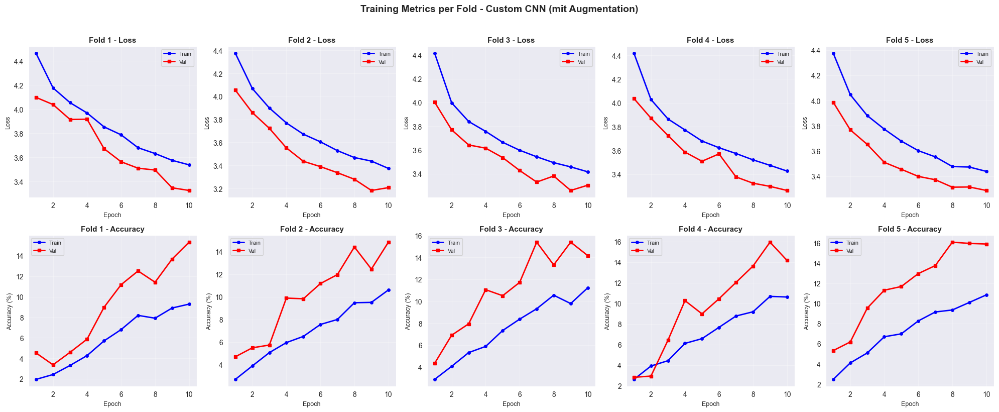

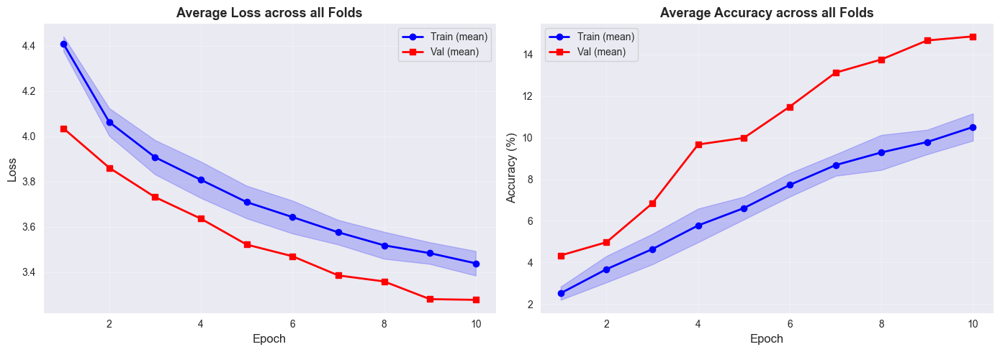

In [23]:
# ========================
# LOSS UND ACCURACY PLOTS - MODELL 3
# ========================
import matplotlib.pyplot as plt
import numpy as np

# Berechne Epochen pro Fold
epochs_per_fold = len(fold_train_losses_m3) // k_folds

print(f"Total epochs: {len(fold_train_losses_m3)}")
print(f"Epochs per fold: {epochs_per_fold}")
print(f"Number of folds: {k_folds}")

# Erstelle Figure mit Subplots für jeden Fold
fig, axes = plt.subplots(2, k_folds, figsize=(20, 8))

for fold in range(k_folds):
    start_idx = fold * epochs_per_fold
    end_idx = (fold + 1) * epochs_per_fold
    
    fold_epochs = range(1, epochs_per_fold + 1)
    fold_train_loss = fold_train_losses_m3[start_idx:end_idx]
    fold_val_loss = fold_val_losses_m3[start_idx:end_idx]
    fold_train_acc = fold_train_accs_m3[start_idx:end_idx]
    fold_val_acc = fold_val_accs_m3[start_idx:end_idx]
    
    # Loss Plot
    axes[0, fold].plot(fold_epochs, fold_train_loss, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[0, fold].plot(fold_epochs, fold_val_loss, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[0, fold].set_title(f'Fold {fold + 1} - Loss', fontsize=11, fontweight='bold')
    axes[0, fold].set_xlabel('Epoch', fontsize=9)
    axes[0, fold].set_ylabel('Loss', fontsize=9)
    axes[0, fold].legend(fontsize=8)
    axes[0, fold].grid(True, alpha=0.3)
    
    # Accuracy Plot
    axes[1, fold].plot(fold_epochs, fold_train_acc, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[1, fold].plot(fold_epochs, fold_val_acc, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[1, fold].set_title(f'Fold {fold + 1} - Accuracy', fontsize=11, fontweight='bold')
    axes[1, fold].set_xlabel('Epoch', fontsize=9)
    axes[1, fold].set_ylabel('Accuracy (%)', fontsize=9)
    axes[1, fold].legend(fontsize=8)
    axes[1, fold].grid(True, alpha=0.3)

plt.suptitle('Training Metrics per Fold - Custom CNN (mit Augmentation)', fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# Durchschnittlicher Verlauf über alle Folds
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Reshape losses zu (k_folds, epochs_per_fold)
train_losses_reshaped = np.array(fold_train_losses_m3).reshape(k_folds, epochs_per_fold)
val_losses_reshaped = np.array(fold_val_losses_m3).reshape(k_folds, epochs_per_fold)
train_accs_reshaped = np.array(fold_train_accs_m3).reshape(k_folds, epochs_per_fold)
val_accs_reshaped = np.array(fold_val_accs_m3).reshape(k_folds, epochs_per_fold)

# Durchschnitt und Standardabweichung
mean_train_loss = train_losses_reshaped.mean(axis=0)
std_train_loss = train_losses_reshaped.std(axis=0)
mean_val_loss = val_losses_reshaped.mean(axis=0)
std_val_loss = val_losses_reshaped.std(axis=0)

mean_train_acc = train_accs_reshaped.mean(axis=0)
std_train_acc = train_accs_reshaped.std(axis=0)
mean_val_acc = val_accs_reshaped.mean(axis=0)
std_val_acc = val_accs_reshaped.std(axis=0)

epochs = range(1, epochs_per_fold + 1)

# Average Loss Plot mit Konfidenzintervall
ax1.plot(epochs, mean_train_loss, 'b-o', label='Train (mean)', linewidth=2)
ax1.fill_between(epochs, mean_train_loss - std_train_loss, mean_train_loss + std_train_loss, alpha=0.2, color='blue')
ax1.plot(epochs, mean_val_loss, 'r-s', label='Val (mean)', linewidth=2)
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.set_title('Average Loss across all Folds', fontsize=13, fontweight='bold')
ax1.legend(fontsize=10)
ax1.grid(True, alpha=0.3)

# Average Accuracy Plot mit Konfidenzintervall
ax2.plot(epochs, mean_train_acc, 'b-o', label='Train (mean)', linewidth=2)
ax2.fill_between(epochs, mean_train_acc - std_train_acc, mean_train_acc + std_train_acc, alpha=0.2, color='blue')
ax2.plot(epochs, mean_val_acc, 'r-s', label='Val (mean)', linewidth=2)
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Accuracy (%)', fontsize=12)
ax2.set_title('Average Accuracy across all Folds', fontsize=13, fontweight='bold')
ax2.legend(fontsize=10)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Modell 4: ResNet18 ohne Data Augmentation


========== Fold 1/5 ==========

RESNET18 (OHNE AUGMENTATION) - ARCHITECTURE SUMMARY
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, mom

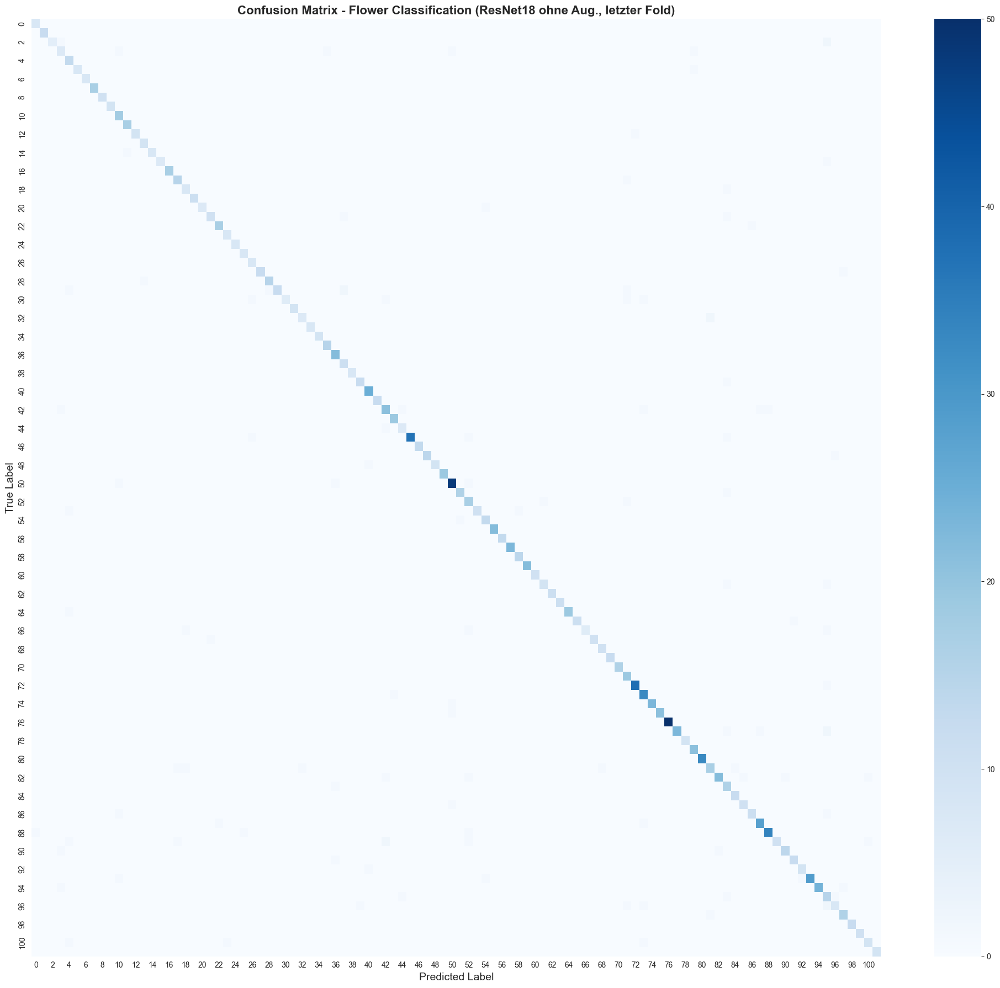

In [24]:
# ================================
# RESNET18 OHNE DATA AUGMENTATION
# ================================

from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix
import seaborn as sns
import time

# Stratified K-Fold
k_folds = 5
epochs = 10
patience_early_stop = 2
batch_size = 32

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
y = labels - 1  # 0–101

skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=1)
indices = np.arange(len(labels))
fold_accuracies_resnet_no_aug = []
fold_f1_scores_resnet_no_aug = []
fold_train_losses_m4 = []
fold_val_losses_m4 = []
fold_train_accs_m4 = []
fold_val_accs_m4 = []

# Zeitmessung starten
train_start_time_model4 = time.time()

# Cross-Validation Loop
for fold, (train_idx, test_idx) in enumerate(skf.split(indices, y)):
    print(f"\n========== Fold {fold + 1}/{k_folds} ==========")

    # OHNE Augmentation - nur test_transform für beide
    train_dataset = FlowersDataset(
        data_dir, labels, train_idx, test_transform
    )
    test_dataset = FlowersDataset(
        data_dir, labels, test_idx, test_transform
    )

    assert len(train_dataset) > 0, "Train dataset is empty!"
    assert len(test_dataset) > 0, "Test dataset is empty!"

    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=0,
        pin_memory=True
    )

    model = create_resnet_model(num_classes=102).to(device)
    
    # Modell-Beschreibung (nur beim ersten Fold)
    if fold == 0:
        describe_model(model, "ResNet18 (ohne Augmentation)")
    
    class_weights = compute_class_weights(
        labels, train_idx, num_classes=102
    ).to(device)
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

    # Early stopping
    # early_stopping = EarlyStopping(patience=patience_early_stop, verbose=True)

    for epoch in range(epochs):
        train_loss, train_acc = train_one_epoch(
            model, train_loader, optimizer, criterion, device
        )
        val_loss, val_acc = evaluate(
            model, test_loader, criterion, device
        )
        
        # Store history
        fold_train_losses_m4.append(train_loss)
        fold_val_losses_m4.append(val_loss)
        fold_train_accs_m4.append(train_acc)
        fold_val_accs_m4.append(val_acc)

        print(
            f"Epoch [{epoch+1}/{epochs}] | "
            f"Train Acc: {train_acc:.2f}% | "
            f"Val Acc: {val_acc:.2f}%"
        )

        # if early_stopping(val_loss):
        #     print(f"Early stopping triggered at epoch {epoch+1}")
        #     break

    # Finale Evaluation mit Predictions
    test_loss, test_acc, preds, true_labels = evaluate(
        model, test_loader, criterion, device, return_predictions=True
    )
    
    # F1-Score berechnen
    f1_macro = f1_score(true_labels, preds, average='macro')
    f1_weighted = f1_score(true_labels, preds, average='weighted')

    print(f"Test Accuracy Fold {fold + 1}: {test_acc:.2f}%")
    print(f"F1-Score (macro): {f1_macro:.4f}")
    print(f"F1-Score (weighted): {f1_weighted:.4f}")
    
    fold_accuracies_resnet_no_aug.append(test_acc)
    fold_f1_scores_resnet_no_aug.append(f1_macro)

# Zeitmessung beenden
train_end_time_model4 = time.time()
train_duration_model4 = train_end_time_model4 - train_start_time_model4

# Ergebnisse
fold_accuracies_resnet_no_aug = np.array(fold_accuracies_resnet_no_aug)
fold_f1_scores_resnet_no_aug = np.array(fold_f1_scores_resnet_no_aug)

print("\n===== Stratified K-Fold Results (ResNet18 ohne Augmentation) =====")
print(f"Fold Accuracies: {fold_accuracies_resnet_no_aug}")
print(f"Mean Accuracy: {fold_accuracies_resnet_no_aug.mean():.2f}%")
print(f"Std Deviation: {fold_accuracies_resnet_no_aug.std():.2f}%")
print(f"\nFold F1-Scores (macro): {fold_f1_scores_resnet_no_aug}")
print(f"Mean F1-Score: {fold_f1_scores_resnet_no_aug.mean():.4f}")
print(f"Std Deviation: {fold_f1_scores_resnet_no_aug.std():.4f}")
print(f"\nTraining Duration: {train_duration_model4/60:.2f} minutes ({train_duration_model4:.2f} seconds)")

# Speichere Ergebnisse für Vergleich
results_model3 = {
    'name': 'ResNet18 (ohne Augmentation)',
    'mean_accuracy': fold_accuracies_resnet_no_aug.mean(),
    'std_accuracy': fold_accuracies_resnet_no_aug.std(),
    'mean_f1': fold_f1_scores_resnet_no_aug.mean(),
    'std_f1': fold_f1_scores_resnet_no_aug.std(),
    'duration': train_duration_model4
}

# Confusion Matrix für letzten Fold
print("\n===== Confusion Matrix (letzter Fold - ResNet18 ohne Augmentation) =====")
cm3 = confusion_matrix(true_labels, preds)
plt.figure(figsize=(20, 18))
sns.heatmap(cm3, annot=False, fmt='d', cmap='Blues', cbar=True)
plt.title('Confusion Matrix - Flower Classification (ResNet18 ohne Aug., letzter Fold)', fontsize=16, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=14)
plt.ylabel('True Label', fontsize=14)
plt.tight_layout()
plt.show()

Total epochs: 50
Epochs per fold: 10
Number of folds: 5


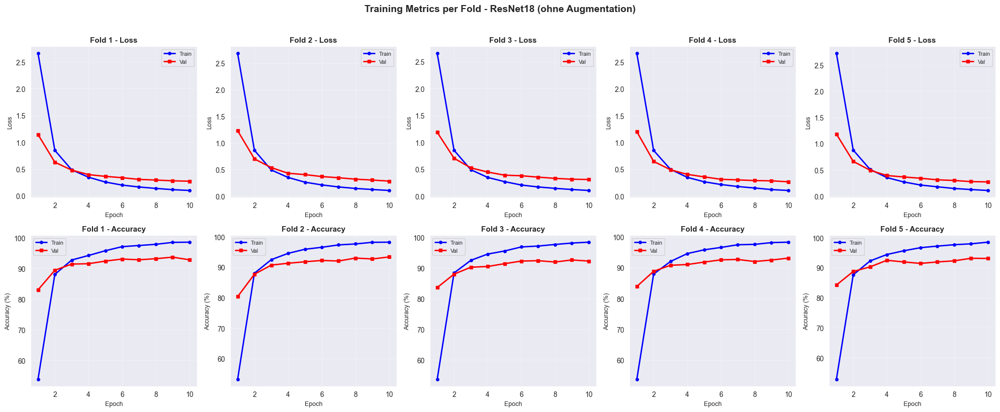

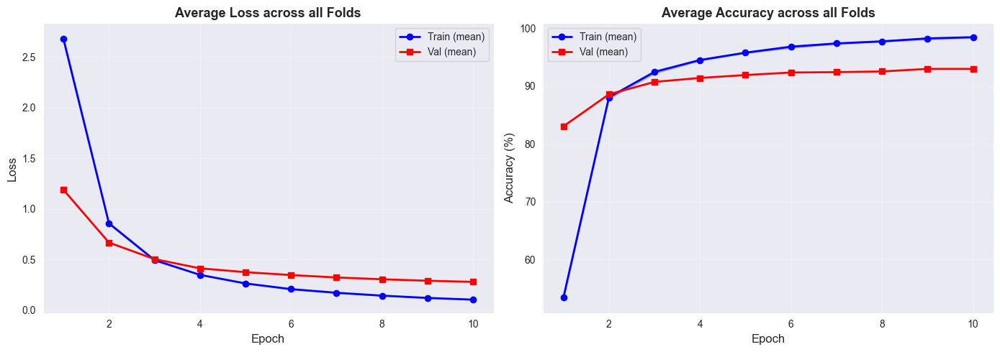

In [25]:
# ========================
# LOSS UND ACCURACY PLOTS - MODELL 4
# ========================
import matplotlib.pyplot as plt
import numpy as np

# Berechne Epochen pro Fold
epochs_per_fold = len(fold_train_losses_m4) // k_folds

print(f"Total epochs: {len(fold_train_losses_m4)}")
print(f"Epochs per fold: {epochs_per_fold}")
print(f"Number of folds: {k_folds}")

# Erstelle Figure mit Subplots für jeden Fold
fig, axes = plt.subplots(2, k_folds, figsize=(20, 8))

for fold in range(k_folds):
    start_idx = fold * epochs_per_fold
    end_idx = (fold + 1) * epochs_per_fold
    
    fold_epochs = range(1, epochs_per_fold + 1)
    fold_train_loss = fold_train_losses_m4[start_idx:end_idx]
    fold_val_loss = fold_val_losses_m4[start_idx:end_idx]
    fold_train_acc = fold_train_accs_m4[start_idx:end_idx]
    fold_val_acc = fold_val_accs_m4[start_idx:end_idx]
    
    # Loss Plot
    axes[0, fold].plot(fold_epochs, fold_train_loss, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[0, fold].plot(fold_epochs, fold_val_loss, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[0, fold].set_title(f'Fold {fold + 1} - Loss', fontsize=11, fontweight='bold')
    axes[0, fold].set_xlabel('Epoch', fontsize=9)
    axes[0, fold].set_ylabel('Loss', fontsize=9)
    axes[0, fold].legend(fontsize=8)
    axes[0, fold].grid(True, alpha=0.3)
    
    # Accuracy Plot
    axes[1, fold].plot(fold_epochs, fold_train_acc, 'b-o', label='Train', linewidth=2, markersize=4)
    axes[1, fold].plot(fold_epochs, fold_val_acc, 'r-s', label='Val', linewidth=2, markersize=4)
    axes[1, fold].set_title(f'Fold {fold + 1} - Accuracy', fontsize=11, fontweight='bold')
    axes[1, fold].set_xlabel('Epoch', fontsize=9)
    axes[1, fold].set_ylabel('Accuracy (%)', fontsize=9)
    axes[1, fold].legend(fontsize=8)
    axes[1, fold].grid(True, alpha=0.3)

plt.suptitle('Training Metrics per Fold - ResNet18 (ohne Augmentation)', fontsize=14, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# Durchschnittlicher Verlauf über alle Folds
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Reshape losses zu (k_folds, epochs_per_fold)
train_losses_reshaped = np.array(fold_train_losses_m4).reshape(k_folds, epochs_per_fold)
val_losses_reshaped = np.array(fold_val_losses_m4).reshape(k_folds, epochs_per_fold)
train_accs_reshaped = np.array(fold_train_accs_m4).reshape(k_folds, epochs_per_fold)
val_accs_reshaped = np.array(fold_val_accs_m4).reshape(k_folds, epochs_per_fold)

# Durchschnitt und Standardabweichung
mean_train_loss = train_losses_reshaped.mean(axis=0)
std_train_loss = train_losses_reshaped.std(axis=0)
mean_val_loss = val_losses_reshaped.mean(axis=0)
std_val_loss = val_losses_reshaped.std(axis=0)

mean_train_acc = train_accs_reshaped.mean(axis=0)
std_train_acc = train_accs_reshaped.std(axis=0)
mean_val_acc = val_accs_reshaped.mean(axis=0)
std_val_acc = val_accs_reshaped.std(axis=0)

epochs = range(1, epochs_per_fold + 1)

# Average Loss Plot mit Konfidenzintervall
ax1.plot(epochs, mean_train_loss, 'b-o', label='Train (mean)', linewidth=2)
ax1.fill_between(epochs, mean_train_loss - std_train_loss, mean_train_loss + std_train_loss, alpha=0.2, color='blue')
ax1.plot(epochs, mean_val_loss, 'r-s', label='Val (mean)', linewidth=2)
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.set_title('Average Loss across all Folds', fontsize=13, fontweight='bold')
ax1.legend(fontsize=10)
ax1.grid(True, alpha=0.3)

# Average Accuracy Plot mit Konfidenzintervall
ax2.plot(epochs, mean_train_acc, 'b-o', label='Train (mean)', linewidth=2)
ax2.fill_between(epochs, mean_train_acc - std_train_acc, mean_train_acc + std_train_acc, alpha=0.2, color='blue')
ax2.plot(epochs, mean_val_acc, 'r-s', label='Val (mean)', linewidth=2)
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Accuracy (%)', fontsize=12)
ax2.set_title('Average Accuracy across all Folds', fontsize=13, fontweight='bold')
ax2.legend(fontsize=10)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Vergleich aller Modelle

Modell                         | Mean Accuracy (%) | Mean F1-Score   | Training Zeit (min) | Training Zeit (sek)
-------------------------------+-------------------+-----------------+---------------------+--------------------
Custom CNN (ohne Augmentation) | 17.58 ± 0.94      | 0.1181 ± 0.0116 | 45.85               | 2751.03            
ResNet18 (ohne Augmentation)   | 92.95 ± 0.37      | 0.9245 ± 0.0053 | 28.99               | 1739.27            
Custom CNN (mit Augmentation)  | 14.87 ± 0.67      | 0.1007 ± 0.0062 | 48.51               | 2910.88            
ResNet18 (with Augmentation)   | 90.54 ± 0.48      | 0.9004 ± 0.0052 | 33.94               | 2036.18            


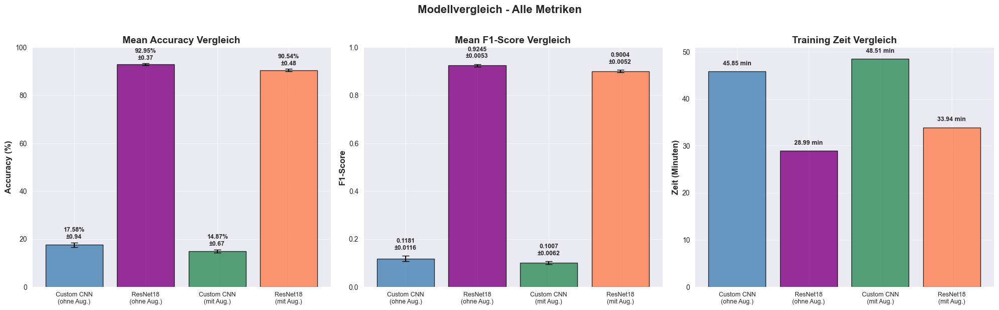


 BESTE PERFORMANCE:
   Beste Accuracy: ResNet18 (ohne Augmentation) mit 92.95%
   Bester F1-Score: ResNet18 (ohne Augmentation) mit 0.9245
   Schnellstes Training: ResNet18 (ohne Augmentation) mit 28.99 Minuten


In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def print_aligned_table(df):
    """
    Druckt DataFrame als fixed-width Tabelle (keine externen Abhängigkeiten).
    Übergib z.B. df_comparison.
    """
    if df is None or df.shape[0] == 0:
        print("Keine Daten zum Anzeigen.")
        return

    cols = list(df.columns)
    rows = df.astype(str).values.tolist()

    # Spaltenbreiten berechnen
    widths = []
    for i, col in enumerate(cols):
        max_cell = max((len(row[i]) for row in rows), default=0)
        widths.append(max(len(str(col)), max_cell))

    sep = " | "
    header = sep.join(str(col).ljust(widths[i]) for i, col in enumerate(cols))
    divider = "-+-".join("-" * widths[i] for i in range(len(widths)))
    top = "=" * len(divider)

    print(top)
    print(header)
    print(divider)
    for row in rows:
        print(sep.join(str(row[i]).ljust(widths[i]) for i in range(len(cols))))
    print(top)


# Korrekte Reihenfolge: ohne Aug. zuerst, dann mit Aug.
comparison_data = {
    'Modell': [
        results_model1['name'],  # Custom CNN ohne Aug.
        results_model3['name'],  # ResNet18 ohne Aug.
        results_model2['name'],  # Custom CNN mit Aug.
        results_model4['name']   # ResNet18 mit Aug.
    ],
    'Mean Accuracy (%)': [
        f"{results_model1['mean_accuracy']:.2f} ± {results_model1['std_accuracy']:.2f}",
        f"{results_model3['mean_accuracy']:.2f} ± {results_model3['std_accuracy']:.2f}",
        f"{results_model2['mean_accuracy']:.2f} ± {results_model2['std_accuracy']:.2f}",
        f"{results_model4['mean_accuracy']:.2f} ± {results_model4['std_accuracy']:.2f}"
    ],
    'Mean F1-Score': [
        f"{results_model1['mean_f1']:.4f} ± {results_model1['std_f1']:.4f}",
        f"{results_model3['mean_f1']:.4f} ± {results_model3['std_f1']:.4f}",
        f"{results_model2['mean_f1']:.4f} ± {results_model2['std_f1']:.4f}",
        f"{results_model4['mean_f1']:.4f} ± {results_model4['std_f1']:.4f}"
    ],
    'Training Zeit (min)': [
        f"{results_model1['duration']/60:.2f}",
        f"{results_model3['duration']/60:.2f}",
        f"{results_model2['duration']/60:.2f}",
        f"{results_model4['duration']/60:.2f}"
    ],
    'Training Zeit (sek)': [
        f"{results_model1['duration']:.2f}",
        f"{results_model3['duration']:.2f}",
        f"{results_model2['duration']:.2f}",
        f"{results_model4['duration']:.2f}"
    ]
}

df_comparison = pd.DataFrame(comparison_data)
print_aligned_table(df_comparison)

# Korrekte Reihenfolge: ohne Aug. zuerst, dann mit Aug.
models = [
    results_model1['name'],  # Custom CNN ohne Aug.
    results_model3['name'],  # ResNet18 ohne Aug.
    results_model2['name'],  # Custom CNN mit Aug.
    results_model4['name']   # ResNet18 mit Aug.
]
accuracies = [
    results_model1['mean_accuracy'],
    results_model3['mean_accuracy'],
    results_model2['mean_accuracy'],
    results_model4['mean_accuracy']
]
std_accs = [
    results_model1['std_accuracy'],
    results_model3['std_accuracy'],
    results_model2['std_accuracy'],
    results_model4['std_accuracy']
]
f1_scores = [
    results_model1['mean_f1'],
    results_model3['mean_f1'],
    results_model2['mean_f1'],
    results_model4['mean_f1']
]
std_f1s = [
    results_model1['std_f1'],
    results_model3['std_f1'],
    results_model2['std_f1'],
    results_model4['std_f1']
]
durations = [
    results_model1['duration'] / 60,
    results_model3['duration'] / 60,
    results_model2['duration'] / 60,
    results_model4['duration'] / 60
]

x_pos = np.arange(len(models))
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

xt_labels = [
    'Custom CNN\n(ohne Aug.)',
    'ResNet18\n(ohne Aug.)',
    'Custom CNN\n(mit Aug.)',
    'ResNet18\n(mit Aug.)'
]

# Farben: Blau/Lila für ohne Aug., Grün/Orange für mit Aug.
colors = ['steelblue', 'purple', 'seagreen', 'coral']

# Accuracy
bars1 = axes[0].bar(x_pos, accuracies, yerr=std_accs, capsize=5,
                    color=colors, edgecolor='black', alpha=0.8)
axes[0].set_ylabel('Accuracy (%)', fontsize=12, fontweight='bold')
axes[0].set_title('Mean Accuracy Vergleich', fontsize=14, fontweight='bold')
axes[0].set_xticks(x_pos)
axes[0].set_xticklabels(xt_labels, fontsize=9)
axes[0].grid(axis='y', alpha=0.3)
axes[0].set_ylim([0, 100])
for bar, acc, std in zip(bars1, accuracies, std_accs):
    h = bar.get_height()
    axes[0].text(bar.get_x() + bar.get_width() / 2., h + std + 1,
                 f'{acc:.2f}%\n±{std:.2f}', ha='center', va='bottom', fontsize=9, fontweight='bold')

# F1-Score
bars2 = axes[1].bar(x_pos, f1_scores, yerr=std_f1s, capsize=5,
                    color=colors, edgecolor='black', alpha=0.8)
axes[1].set_ylabel('F1-Score', fontsize=12, fontweight='bold')
axes[1].set_title('Mean F1-Score Vergleich', fontsize=14, fontweight='bold')
axes[1].set_xticks(x_pos)
axes[1].set_xticklabels(xt_labels, fontsize=9)
axes[1].grid(axis='y', alpha=0.3)
axes[1].set_ylim([0, 1.0])
for bar, f1, std in zip(bars2, f1_scores, std_f1s):
    h = bar.get_height()
    axes[1].text(bar.get_x() + bar.get_width() / 2., h + std + 0.02,
                 f'{f1:.4f}\n±{std:.4f}', ha='center', va='bottom', fontsize=9, fontweight='bold')

# Trainingszeit
bars3 = axes[2].bar(x_pos, durations, color=colors, edgecolor='black', alpha=0.8)
axes[2].set_ylabel('Zeit (Minuten)', fontsize=12, fontweight='bold')
axes[2].set_title('Training Zeit Vergleich', fontsize=14, fontweight='bold')
axes[2].set_xticks(x_pos)
axes[2].set_xticklabels(xt_labels, fontsize=9)
axes[2].grid(axis='y', alpha=0.3)
max_dur = max(durations) if durations else 0.0
for bar, dur in zip(bars3, durations):
    h = bar.get_height()
    axes[2].text(bar.get_x() + bar.get_width() / 2., h + max_dur * 0.02,
                 f'{dur:.2f} min', ha='center', va='bottom', fontsize=9, fontweight='bold')

plt.suptitle('Modellvergleich - Alle Metriken', fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# Beste Performance
best_accuracy_idx = np.argmax(accuracies)
best_f1_idx = np.argmax(f1_scores)
fastest_idx = np.argmin(durations)

print("\n BESTE PERFORMANCE:")
print(f"   Beste Accuracy: {models[best_accuracy_idx]} mit {accuracies[best_accuracy_idx]:.2f}%")
print(f"   Bester F1-Score: {models[best_f1_idx]} mit {f1_scores[best_f1_idx]:.4f}")
print(f"   Schnellstes Training: {models[fastest_idx]} mit {durations[fastest_idx]:.2f} Minuten")


Evalauation der Predictions - Mögliche Interpretationen

1. VISUELL ÄHNLICHKEIT:
   - Schwierige Klassen: Blumen mit sehr ähnlichem Aussehen, Farbe, Form
   - Einfache Klassen: Blumen mit charakteristischen, einzigartigen Merkmalen

2. TRAININGSDATENQUALITÄT:
   - Support-Differenzen können auf Imbalance hindeuten
   - Einige Klassen haben möglicherweise bessere/schlechtere Fotografien

3. MODELLKAPAZITÄT:
   - ResNet18 Transfer Learning sollte bei schwierigen Klassen besser abschneiden
   - Custom CNN ohne Augmentation sollte bei einfachen Klassen ausreichend sein

4. KLASSENGRÖSSE (SUPPORT):
   - Größere Klassen mit mehr Samples sollten generell besser trainierbar sein
   - Kleine Klassen können Overfitting-Probleme haben

In [27]:
from sklearn.metrics import precision_recall_fscore_support
import pandas as pd

def analyze_model_classes(cm3, preds, true_labels, model_name):
    precision, recall, f1, support = precision_recall_fscore_support(true_labels, preds, average=None)
    class_metrics = pd.DataFrame({
        'Klasse': range(0, 102),
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'Support': support,
        'Correct': np.diag(cm3),
    })
    class_metrics['Accuracy'] = class_metrics.apply(
        lambda row: row['Correct'] / row['Support'] if row['Support'] > 0 else 0,
        axis=1
    )
    sorted_metrics = class_metrics.sort_values('F1-Score', ascending=False)
    top_5_best = sorted_metrics.head(5).reset_index(drop=True)
    top_5_worst = sorted_metrics.tail(5).reset_index(drop=True)
    
    return {
        'model_name': model_name,
        'all_metrics': class_metrics,
        'top_5_best': top_5_best,
        'top_5_worst': top_5_worst,
        'cm3': cm3,
        'preds': preds,
        'true_labels': true_labels
    }

model_analysis_results = {}

In [28]:
available_data = []

try:
    # ResNet18 (ohne Augmentation)
    if 'cm3' in locals() and hasattr(cm3, 'shape'):
        print("Confusion Matrix für Model 3 gefunden")
        available_data.append(('cm3', 'preds', 'true_labels', 'Model 3: ResNet18 (ohne Augmentation)'))
except:
    pass

print("\nVerfügbare Daten für Analyse:")
if 'cm3' in locals():
    print(f"  - Confusion Matrix Shape: {cm3.shape}")
if 'preds' in locals():
    print(f"  - Predictions verfügbar: {len(preds)} Samples")
if 'true_labels' in locals():
    print(f"  - True Labels verfügbar: {len(true_labels)} Samples")
    
if 'cm3' in locals() and 'preds' in locals() and 'true_labels' in locals():
    precision, recall, f1, support = precision_recall_fscore_support(true_labels, preds, average=None)
    class_metrics = pd.DataFrame({
        'Klasse': range(0, 102),
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'Support': support,
        'Korrekt': np.diag(cm3),
    })
    class_metrics['Accuracy'] = class_metrics.apply(
        lambda row: (row['Korrekt'] / row['Support'] * 100) if row['Support'] > 0 else 0,
        axis=1
    )
    sorted_metrics = class_metrics.sort_values('F1-Score', ascending=False).reset_index(drop=True)
    
    print("TOP 5 BESTE KLASSEN (höchster F1-Score)")
    top_5_best = sorted_metrics.head(5)
    print(top_5_best[['Klasse', 'F1-Score', 'Precision', 'Recall', 'Accuracy', 'Support']].to_string(index=False))
    
    print("TOP 5 SCHLECHTESTE KLASSEN (niedrigster F1-Score)")
    top_5_worst = sorted_metrics.tail(5)
    print(top_5_worst[['Klasse', 'F1-Score', 'Precision', 'Recall', 'Accuracy', 'Support']].to_string(index=False))
    last_model_metrics = {
        'all_metrics': class_metrics,
        'top_5_best': top_5_best,
        'top_5_worst': top_5_worst,
        'cm3': cm3
    }
    
else:
    print("\n Keine Confusion Matrix verfügbar!")


Confusion Matrix für Model 3 gefunden

Verfügbare Daten für Analyse:
  - Confusion Matrix Shape: (102, 102)
  - Predictions verfügbar: 1637 Samples
  - True Labels verfügbar: 1637 Samples
TOP 5 BESTE KLASSEN (höchster F1-Score)
 Klasse  F1-Score  Precision  Recall  Accuracy  Support
      1       1.0        1.0     1.0     100.0       12
     19       1.0        1.0     1.0     100.0       11
      9       1.0        1.0     1.0     100.0        9
      8       1.0        1.0     1.0     100.0       10
      7       1.0        1.0     1.0     100.0       17
TOP 5 SCHLECHTESTE KLASSEN (niedrigster F1-Score)
 Klasse  F1-Score  Precision   Recall  Accuracy  Support
     89  0.769231   1.000000 0.625000 62.500000       16
     30  0.750000   1.000000 0.600000 60.000000       10
     96  0.695652   0.800000 0.615385 61.538462       13
     95  0.681818   0.576923 0.833333 83.333333       18
      3  0.636364   0.636364 0.636364 63.636364       11


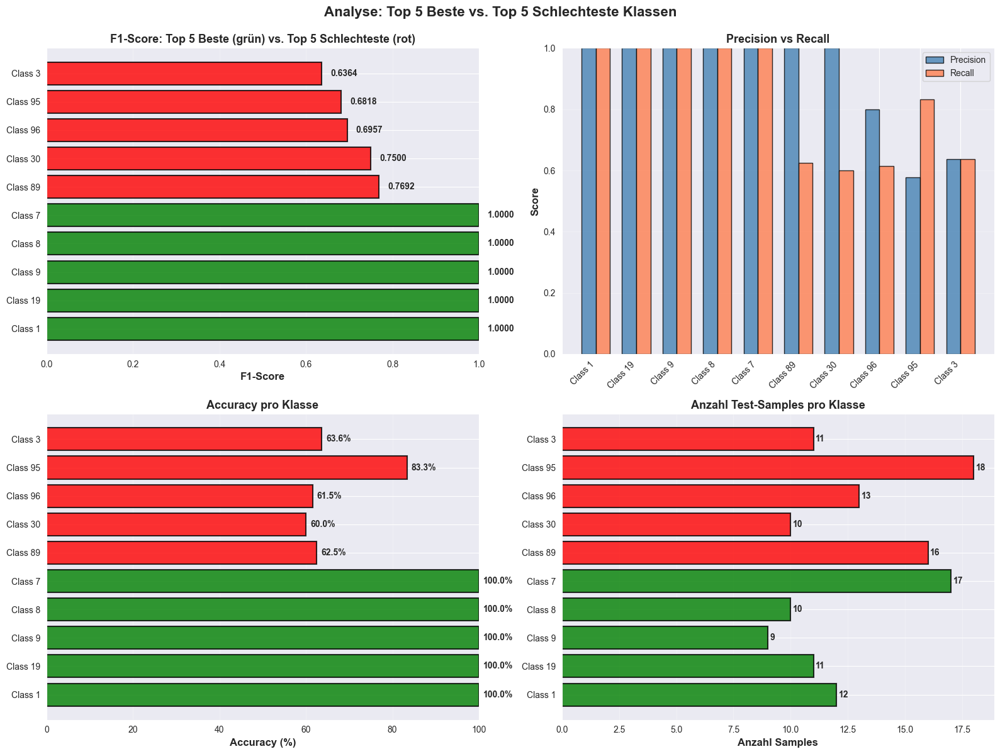

In [29]:
if 'last_model_metrics' in locals():
    top_5_best = last_model_metrics['top_5_best']
    top_5_worst = last_model_metrics['top_5_worst']
    cm3 = last_model_metrics['cm3']
    
    comparison_data = pd.concat([top_5_best, top_5_worst], ignore_index=True)
    comparison_data['Typ'] = ['Best'] * 5 + ['Worst'] * 5
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Analyse: Top 5 Beste vs. Top 5 Schlechteste Klassen', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    # Plot 1: F1-Score
    ax1 = axes[0, 0]
    colors = ['green' if typ == 'Best' else 'red' for typ in comparison_data['Typ']]
    classes_label = [f"Class {int(c)}" for c in comparison_data['Klasse']]
    
    bars1 = ax1.barh(classes_label, comparison_data['F1-Score'], color=colors, 
                     edgecolor='black', alpha=0.8, linewidth=1.5)
    ax1.set_xlabel('F1-Score', fontsize=12, fontweight='bold')
    ax1.set_title('F1-Score: Top 5 Beste (grün) vs. Top 5 Schlechteste (rot)', 
                  fontsize=13, fontweight='bold')
    ax1.set_xlim([0, 1.0])
    ax1.grid(axis='x', alpha=0.3)
    
    for bar, val in zip(bars1, comparison_data['F1-Score']):
        ax1.text(val + 0.02, bar.get_y() + bar.get_height()/2, f'{val:.4f}', 
                va='center', fontsize=10, fontweight='bold')
    
    # Plot 2: Precision vs Recall
    ax2 = axes[0, 1]
    x_pos = np.arange(len(comparison_data))
    width = 0.35
    
    bars_prec = ax2.bar(x_pos - width/2, comparison_data['Precision'], width, 
                        label='Precision', color='steelblue', alpha=0.8, edgecolor='black')
    bars_rec = ax2.bar(x_pos + width/2, comparison_data['Recall'], width, 
                       label='Recall', color='coral', alpha=0.8, edgecolor='black')
    
    ax2.set_ylabel('Score', fontsize=12, fontweight='bold')
    ax2.set_title('Precision vs Recall', fontsize=13, fontweight='bold')
    ax2.set_xticks(x_pos)
    ax2.set_xticklabels(classes_label, rotation=45, ha='right')
    ax2.set_ylim([0, 1.0])
    ax2.legend(fontsize=10)
    ax2.grid(axis='y', alpha=0.3)
    
    # Plot 3: Accuracy pro Klasse
    ax3 = axes[1, 0]
    bars3 = ax3.barh(classes_label, comparison_data['Accuracy'], color=colors, 
                     edgecolor='black', alpha=0.8, linewidth=1.5)
    ax3.set_xlabel('Accuracy (%)', fontsize=12, fontweight='bold')
    ax3.set_title('Accuracy pro Klasse', fontsize=13, fontweight='bold')
    ax3.set_xlim([0, 100])
    ax3.grid(axis='x', alpha=0.3)
    
    for bar, val in zip(bars3, comparison_data['Accuracy']):
        ax3.text(val + 1, bar.get_y() + bar.get_height()/2, f'{val:.1f}%', 
                va='center', fontsize=10, fontweight='bold')
    
    # Plot 4: Anzahl Samples pro Klasse
    ax4 = axes[1, 1]
    bars4 = ax4.barh(classes_label, comparison_data['Support'], color=colors, 
                     edgecolor='black', alpha=0.8, linewidth=1.5)
    ax4.set_xlabel('Anzahl Samples', fontsize=12, fontweight='bold')
    ax4.set_title('Anzahl Test-Samples pro Klasse', fontsize=13, fontweight='bold')
    ax4.grid(axis='x', alpha=0.3)
    
    for bar, val in zip(bars4, comparison_data['Support']):
        ax4.text(val + 0.1, bar.get_y() + bar.get_height()/2, f'{int(val)}', 
                va='center', fontsize=10, fontweight='bold')
    
    plt.tight_layout()
    plt.show()
else:
    print("Keine Daten für Visualisierungen verfügbar")

In [30]:
if 'last_model_metrics' in locals() and 'cm3' in locals():
    top_5_best = last_model_metrics['top_5_best']
    top_5_worst = last_model_metrics['top_5_worst']
    
    avg_f1_best = top_5_best['F1-Score'].mean()
    avg_f1_worst = top_5_worst['F1-Score'].mean()
    avg_accuracy_best = top_5_best['Accuracy'].mean()
    avg_accuracy_worst = top_5_worst['Accuracy'].mean()
    avg_support_best = top_5_best['Support'].mean()
    avg_support_worst = top_5_worst['Support'].mean()
    
    print(f"\nDURCHSCHNITTLICHE METRIKEN:")
    print(f"  Top 5 Beste Klassen:")
    print(f"    - F1-Score:           {avg_f1_best:.4f}")
    print(f"    - Accuracy:           {avg_accuracy_best:.2f}%")
    print(f"    - Durchschn. Samples: {avg_support_best:.1f} Samples")
    
    print(f"\n  Top 5 Schlechteste Klassen:")
    print(f"    - F1-Score:           {avg_f1_worst:.4f}")
    print(f"    - Accuracy:           {avg_accuracy_worst:.2f}%")
    print(f"    - Durchschn. Samples: {avg_support_worst:.1f} Samples")
    
    print(f"\n  UNTERSCHIEDE:")
    print(f"    - F1-Score Differenz: {avg_f1_best - avg_f1_worst:.4f} ({((avg_f1_best - avg_f1_worst) / avg_f1_worst * 100):.1f}% besser)")
    print(f"    - Accuracy Differenz: {avg_accuracy_best - avg_accuracy_worst:.2f} Prozentpunkte")

    print("KLASSEN MIT SCHLECHTESTER VORHERSAGE:")

    for idx, row in top_5_worst.iterrows():
        class_id = int(row['Klasse'])
        confusion_row = cm3[class_id].copy()
        confusion_row[class_id] = -1 
        top_confusion_indices = np.argsort(confusion_row)[-3:][::-1]
        
        print(f"\n  Klasse {class_id} (F1-Score: {row['F1-Score']:.4f}, Accuracy: {row['Accuracy']:.2f}%)")
        print(f"    Korrekt klassifiziert: {int(row['Korrekt'])}/{int(row['Support'])} ({row['Accuracy']:.1f}%)")
        print(f"    Häufigste Verwechslungen:")
        
        for i, conf_class_idx in enumerate(top_confusion_indices, 1):
            conf_count = confusion_row[conf_class_idx]
            if conf_count > 0:
                confusion_pct = (conf_count / row['Support']) * 100
                print(f"      {i}. Mit Klasse {conf_class_idx}: {int(conf_count)} mal ({confusion_pct:.1f}%)")
    print("KLASSEN MIT BESTER VORHERSAGE:")

    
    for idx, row in top_5_best.iterrows():
        class_id = int(row['Klasse'])
        confusion_row = cm3[class_id].copy()
        error_count = row['Support'] - row['Korrekt']
        error_pct = (error_count / row['Support'] * 100) if row['Support'] > 0 else 0
        confusion_row[class_id] = -1
        top_errors_indices = np.argsort(confusion_row)[-2:][::-1]
        
        print(f"\n  Klasse {class_id} (F1-Score: {row['F1-Score']:.4f}, Accuracy: {row['Accuracy']:.2f}%)")
        print(f"    Korrekt klassifiziert: {int(row['Korrekt'])}/{int(row['Support'])} ({row['Accuracy']:.1f}%)")
        print(f"    Fehlerquote: {error_pct:.1f}%")
        
        if error_count > 0:
            print(f"    Häufigste Fehler:")
            for i, err_class_idx in enumerate(top_errors_indices, 1):
                err_count = confusion_row[err_class_idx]
                if err_count > 0:
                    err_pct = (err_count / row['Support']) * 100
                    print(f"      {i}. Mit Klasse {err_class_idx}: {int(err_count)} mal ({err_pct:.1f}%)")
        else:
            print(f"    Perfekte Klassifikation! Keine Fehler.")
else:
    print("Daten nicht verfügbar")


DURCHSCHNITTLICHE METRIKEN:
  Top 5 Beste Klassen:
    - F1-Score:           1.0000
    - Accuracy:           100.00%
    - Durchschn. Samples: 11.8 Samples

  Top 5 Schlechteste Klassen:
    - F1-Score:           0.7066
    - Accuracy:           66.20%
    - Durchschn. Samples: 13.6 Samples

  UNTERSCHIEDE:
    - F1-Score Differenz: 0.2934 (41.5% besser)
    - Accuracy Differenz: 33.80 Prozentpunkte
KLASSEN MIT SCHLECHTESTER VORHERSAGE:

  Klasse 89 (F1-Score: 0.7692, Accuracy: 62.50%)
    Korrekt klassifiziert: 10/16 (62.5%)
    Häufigste Verwechslungen:
      1. Mit Klasse 42: 2 mal (12.5%)
      2. Mit Klasse 100: 1 mal (6.2%)
      3. Mit Klasse 17: 1 mal (6.2%)

  Klasse 30 (F1-Score: 0.7500, Accuracy: 60.00%)
    Korrekt klassifiziert: 6/10 (60.0%)
    Häufigste Verwechslungen:
      1. Mit Klasse 73: 1 mal (10.0%)
      2. Mit Klasse 71: 1 mal (10.0%)
      3. Mit Klasse 26: 1 mal (10.0%)

  Klasse 96 (F1-Score: 0.6957, Accuracy: 61.54%)
    Korrekt klassifiziert: 8/13 (61.5%)

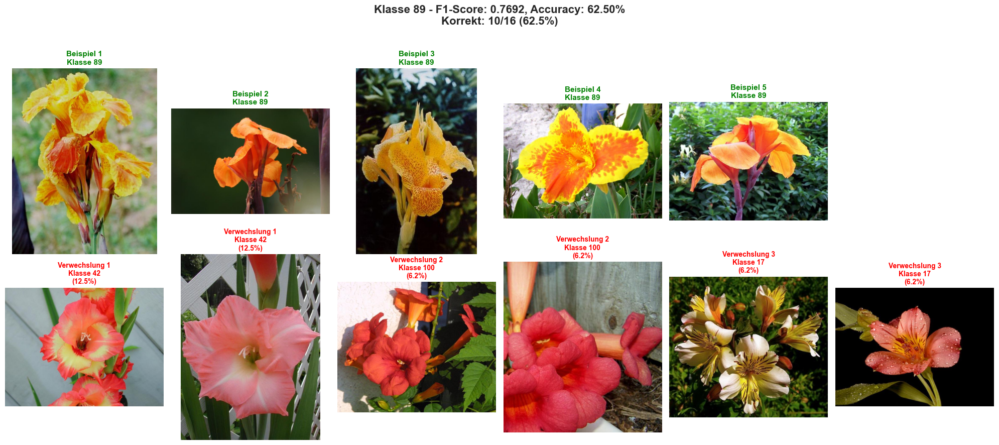


KLASSE 89 - DETAILLIERTE ANALYSE
F1-Score: 0.7692
Accuracy: 62.50%
Precision: 1.0000
Recall: 0.6250
Korrekt klassifiziert: 10/16

Häufigste Verwechslungen:
  1. Mit Klasse 42: 2 mal (12.5%)
  2. Mit Klasse 100: 1 mal (6.2%)
  3. Mit Klasse 17: 1 mal (6.2%)




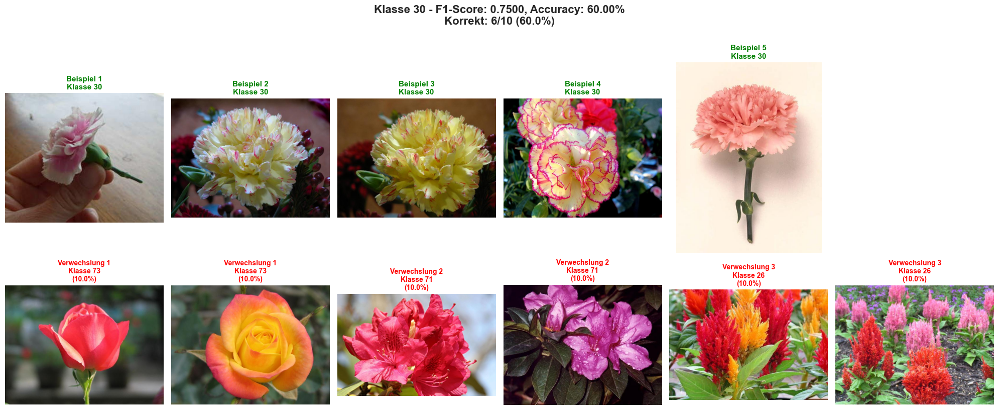


KLASSE 30 - DETAILLIERTE ANALYSE
F1-Score: 0.7500
Accuracy: 60.00%
Precision: 1.0000
Recall: 0.6000
Korrekt klassifiziert: 6/10

Häufigste Verwechslungen:
  1. Mit Klasse 73: 1 mal (10.0%)
  2. Mit Klasse 71: 1 mal (10.0%)
  3. Mit Klasse 26: 1 mal (10.0%)




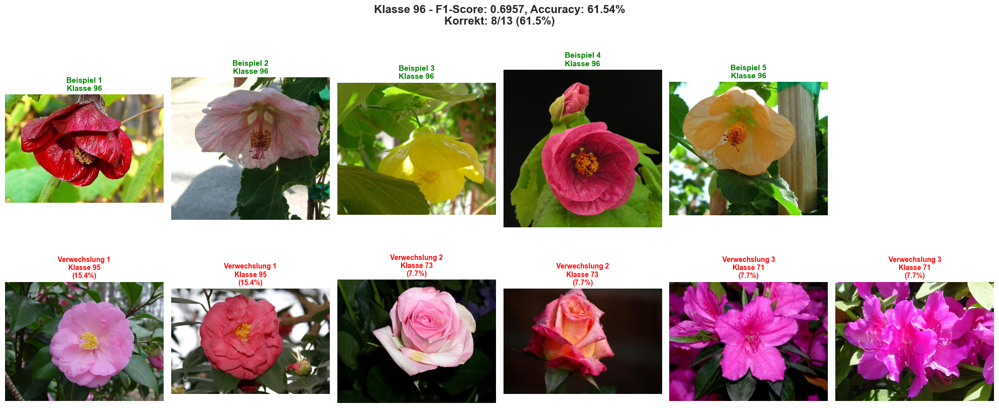


KLASSE 96 - DETAILLIERTE ANALYSE
F1-Score: 0.6957
Accuracy: 61.54%
Precision: 0.8000
Recall: 0.6154
Korrekt klassifiziert: 8/13

Häufigste Verwechslungen:
  1. Mit Klasse 95: 2 mal (15.4%)
  2. Mit Klasse 73: 1 mal (7.7%)
  3. Mit Klasse 71: 1 mal (7.7%)




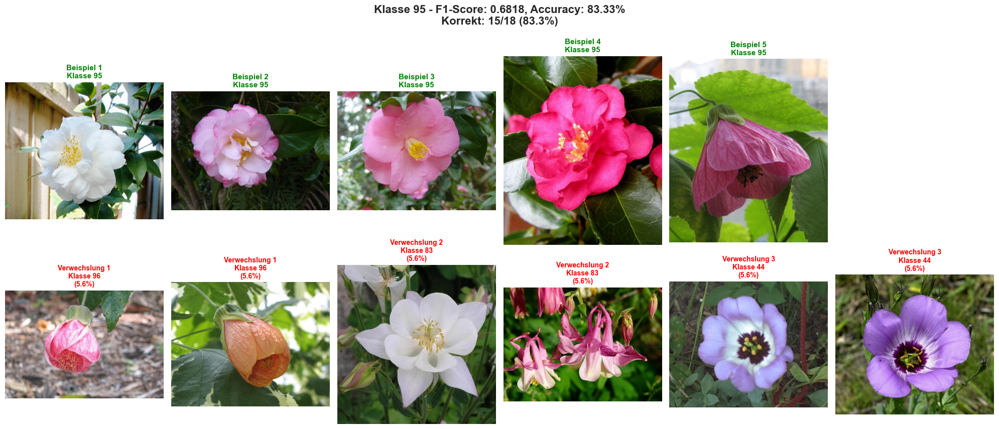


KLASSE 95 - DETAILLIERTE ANALYSE
F1-Score: 0.6818
Accuracy: 83.33%
Precision: 0.5769
Recall: 0.8333
Korrekt klassifiziert: 15/18

Häufigste Verwechslungen:
  1. Mit Klasse 96: 1 mal (5.6%)
  2. Mit Klasse 83: 1 mal (5.6%)
  3. Mit Klasse 44: 1 mal (5.6%)




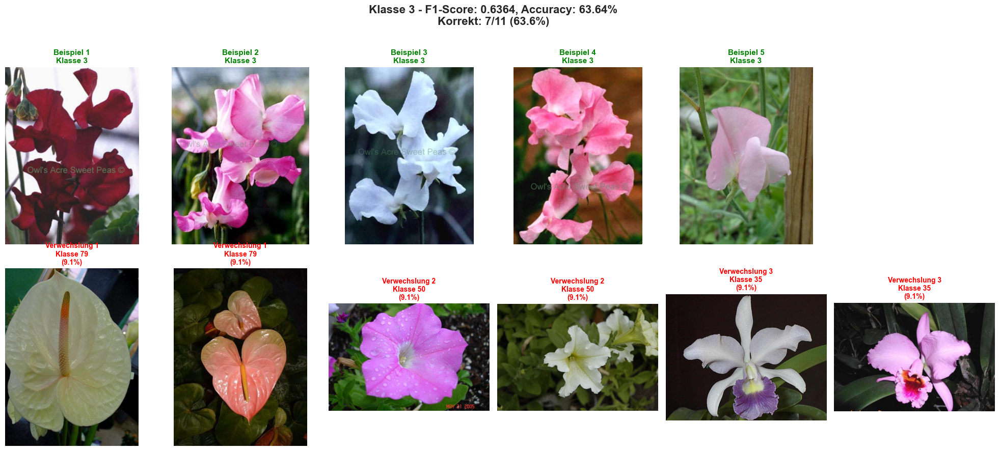


KLASSE 3 - DETAILLIERTE ANALYSE
F1-Score: 0.6364
Accuracy: 63.64%
Precision: 0.6364
Recall: 0.6364
Korrekt klassifiziert: 7/11

Häufigste Verwechslungen:
  1. Mit Klasse 79: 1 mal (9.1%)
  2. Mit Klasse 50: 1 mal (9.1%)
  3. Mit Klasse 35: 1 mal (9.1%)




In [33]:
# python
if 'last_model_metrics' in locals() and 'cm3' in locals():
    top_5_worst = last_model_metrics['top_5_worst']
    cm3 = last_model_metrics['cm3']

    cols = 6  # Anzahl Spalten im Grid (2 x cols) -> genug Plätze für Beispiel- + Verwechslungsbilder

    for idx, row in top_5_worst.iterrows():
        class_id = int(row['Klasse'])

        class_image_indices = [i for i, label in enumerate(labels) if label == (class_id + 1)]

        sample_size = min(5, len(class_image_indices))
        sample_indices = np.random.choice(class_image_indices, size=sample_size, replace=False) if sample_size > 0 else []

        confusion_row = cm3[class_id].copy()
        confusion_row[class_id] = -1
        top_confusion_indices = np.argsort(confusion_row)[-3:][::-1]

        fig = plt.figure(figsize=(20, 9))
        fig.suptitle(
            f'Klasse {class_id} - F1-Score: {row["F1-Score"]:.4f}, Accuracy: {row["Accuracy"]:.2f}%\n'
            f'Korrekt: {int(row["Korrekt"])}/{int(row["Support"])} ({row["Accuracy"]:.1f}%)',
            fontsize=16, fontweight='bold'
        )

        # Beispielbilder (erste Zeile, Spalten 1..5)
        for i, img_idx in enumerate(sample_indices):
            ax = plt.subplot(2, cols, i + 1)
            img_name = f'image_{img_idx+1:05d}.jpg'
            img_path = os.path.join(data_dir, img_name)

            try:
                img = Image.open(img_path)
                ax.imshow(np.array(img))
                ax.set_title(f'Beispiel {i+1}\nKlasse {class_id}', fontsize=11, fontweight='bold', color='green')
                ax.axis('off')
            except Exception:
                ax.text(0.5, 0.5, 'Fehler', ha='center', va='center')
                ax.axis('off')

        # Verwechslungsbilder (zweite Zeile, beginnen bei Position cols+1)
        for confusion_idx, conf_class_idx in enumerate(top_confusion_indices):
            conf_count = confusion_row[conf_class_idx]
            if conf_count <= 0:
                continue

            confusion_pct = (conf_count / row['Support']) * 100 if row['Support'] > 0 else 0.0

            confusing_image_indices = [i for i, label in enumerate(labels) if label == (conf_class_idx + 1)]
            if not confusing_image_indices:
                continue

            sample_confusing = np.random.choice(confusing_image_indices,
                                               size=min(2, len(confusing_image_indices)),
                                               replace=False)

            for sample_idx, img_idx in enumerate(sample_confusing):
                # Position: erste Verwechslungs-Spalte ist cols+1 (also 6 bei cols=5)
                pos = cols + (confusion_idx * 2) + sample_idx + 1
                # Sicherstellen, dass pos <= 2*cols
                if pos > 2 * cols:
                    continue
                ax = plt.subplot(2, cols, pos)
                img_name = f'image_{img_idx+1:05d}.jpg'
                img_path = os.path.join(data_dir, img_name)

                try:
                    img = Image.open(img_path)
                    ax.imshow(np.array(img))
                    ax.set_title(
                        f'Verwechslung {confusion_idx + 1}\nKlasse {conf_class_idx}\n({confusion_pct:.1f}%)',
                        fontsize=10, fontweight='bold', color='red'
                    )
                    ax.axis('off')
                except Exception:
                    ax.text(0.5, 0.5, 'Fehler', ha='center', va='center')
                    ax.axis('off')

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()

        print(f"\n{'='*80}")
        print(f"KLASSE {class_id} - DETAILLIERTE ANALYSE")
        print(f"{'='*80}")
        print(f"F1-Score: {row['F1-Score']:.4f}")
        print(f"Accuracy: {row['Accuracy']:.2f}%")
        print(f"Precision: {row['Precision']:.4f}")
        print(f"Recall: {row['Recall']:.4f}")
        print(f"Korrekt klassifiziert: {int(row['Korrekt'])}/{int(row['Support'])}")
        print(f"\nHäufigste Verwechslungen:")

        for i, conf_class_idx in enumerate(top_confusion_indices, 1):
            conf_count = confusion_row[conf_class_idx]
            if conf_count > 0:
                confusion_pct = (conf_count / row['Support']) * 100 if row['Support'] > 0 else 0.0
                print(f"  {i}. Mit Klasse {conf_class_idx}: {int(conf_count)} mal ({confusion_pct:.1f}%)")

        print(f"\n")
else:
    print("Keine Daten verfügbar!")
